<a href="https://colab.research.google.com/github/cameaci/Metro_Vancouver/blob/main/Archaeological_Analysis_08_08_2025.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# --- 0  Drive mount & raw load ----------------------------------------------
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:

FILE = "/content/drive/MyDrive/Archaeological Analysis 21.04.2025/Archaeology Branch_sites_with_shell_midden_31jul25.xlsx"  # ⬅️ adjust if needed
df0   = pd.read_excel(FILE)

print(f"▶ rows {len(df0):,}  • columns {df0.shape[1]}")

# -- quick peek of the columns we care about ---------------------------------
cols_of_interest = [
    "OBJECTID", "BORDENNUMBER",
    "MR_GISLATITUDE", "MR_GISLONGITUDE",
    "DM_WIDTH", "TY_WIDTH", "TY_LENGTH"
]
print(df0[cols_of_interest].head().to_markdown())


Mounted at /content/drive
▶ rows 6,204  • columns 84
|    |   OBJECTID | BORDENNUMBER   |   MR_GISLATITUDE |   MR_GISLONGITUDE |   DM_WIDTH |   TY_WIDTH |   TY_LENGTH |
|---:|-----------:|:---------------|-----------------:|------------------:|-----------:|-----------:|------------:|
|  0 |       4787 | DkSr-36        |          49.7183 |          -126.94  |          0 |        nan |         nan |
|  1 |       4758 | EcSp-5         |          50.487  |          -126.545 |          5 |        nan |         nan |
|  2 |       4788 | FlTp-18        |          53.9216 |          -130.666 |         33 |        nan |         nan |
|  3 |       4763 | GcTo-43        |          54.3359 |          -130.347 |         12 |        nan |         nan |
|  4 |       4790 | DcRv-86        |          48.364  |          -123.661 |         10 |        nan |         nan |


In [ ]:
# 1A. Rename for convenience
df = (
    df0
      .rename(columns={
          "OBJECTID":      "id",
          "BORDENNUMBER":  "borden",
          "MR_GISLATITUDE":"lat",
          "MR_GISLONGITUDE":"lon",
          "DM_WIDTH":      "width_m"
      })
)

# 1B. Keep only rows with valid coords AND width>1 m
df = (df
      .assign(width_m=pd.to_numeric(df["width_m"], errors="coerce"))
      .dropna(subset=["lat","lon","width_m"])
      .query("width_m > 1")
      .reset_index(drop=True)
)

print(f"Clean rows {len(df):,}")


Clean rows 5,013


count    5013.000000
mean       35.378105
std        65.292619
min         1.100000
25%         9.000000
50%        15.000000
75%        37.000000
max      1260.000000
Name: width_m, dtype: float64


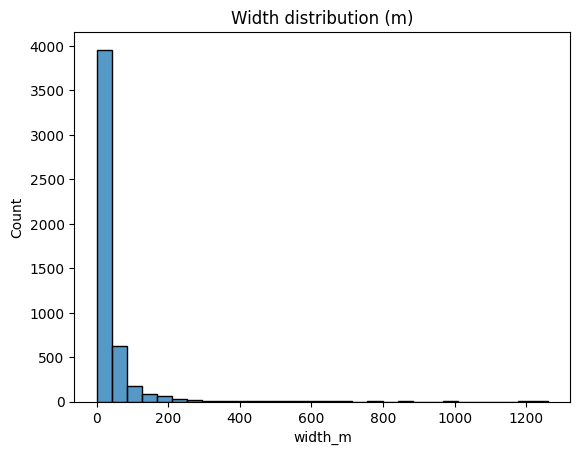

In [ ]:
import seaborn as sns, matplotlib.pyplot as plt

print(df["width_m"].describe())
sns.histplot(df["width_m"], bins=30)
plt.title("Width distribution (m)")
plt.show()


In [ ]:
import geopandas as gpd
from shapely.geometry import Point

gdf = gpd.GeoDataFrame(
        df,
        geometry=[Point(xy) for xy in zip(df.lon, df.lat)],
        crs="EPSG:4326").to_crs(32610)   # UTM Zone 10 N

def buf_class(w):
    if w <= 20:  return 25
    elif w <= 60: return 75
    else:        return 150

gdf["buf_m"] = gdf["width_m"].apply(buf_class)
gdf["buffer"] = gdf.geometry.buffer(gdf.buf_m)


In [ ]:
# spatial index-based overlap count
sidx = gdf.sindex
def neighbours_count(idx, geom):
    cand_idx = list(sidx.intersection(geom.bounds))
    return sum(gdf.loc[cand_idx, "buffer"].intersects(geom)) - 1  # exclude self

gdf["density_n"] = [
    neighbours_count(i, geom) for i, geom in gdf["buffer"].items()
]


In [ ]:
import folium
color = lambda n: ("green" if n<=2 else "orange" if n<=5 else "red")

m = folium.Map(location=[49.2, -123.1], zoom_start=6, tiles="CartoDB positron")

for _, r in gdf.to_crs(4326).iterrows():
    folium.Circle(
        location=[r.geometry.y, r.geometry.x],
        radius=r.buf_m,
        color=color(r.density_n),
        weight=1.5,
        fill=True,
        fill_opacity=0.25,
        popup=f"{r.borden}<br>width {r.width_m} m<br>density {r.density_n}"
    ).add_to(m)

m.save("midden_density_map.html")
m


In [ ]:
import geopandas as gpd
from shapely.geometry import Point

# gdf is the GeoDataFrame produced in the clean step (EPSG:4326 at this point)
gdf = gpd.GeoDataFrame(
    df,
    geometry=[Point(xy) for xy in zip(df.lon, df.lat)],
    crs="EPSG:4326"
).to_crs(32610)                      # work in metres

# --- a) drop perfect duplicates (same lon/lat rounded to 6 dp) ------------
gdf["coord_key"] = (
    gdf.geometry.x.round(6).astype(str)
    + "_"
    + gdf.geometry.y.round(6).astype(str)
)
gdf = gdf.drop_duplicates(subset=["coord_key", "borden"])

# --- b) merge points closer than 1 m (tolerance) --------------------------
tol = 1      # metres
gdf["tmpbuf"] = gdf.geometry.buffer(tol)

# spatial join on 1-m buffer; capture left index
joined = (
    gpd.sjoin(
        gdf[["borden", "width_m", "tmpbuf"]]
          .set_geometry("tmpbuf"),
        gdf.drop(columns="tmpbuf"),
        how="left",
        predicate="intersects"
    )
    .reset_index()                          # old index → column
    .rename(columns={"index": "index_left"})
)

# compute the minimal index_right per index_left
min_right = joined.groupby("index_left")["index_right"].min()

# map that back to gdf
gdf["cluster_id"] = gdf.index.map(min_right)

# Keep one row per cluster (highest width_m); drop temp cols
gdf = (
    gdf.sort_values("width_m", ascending=False)
       .drop_duplicates(subset="cluster_id")
       .drop(columns=["tmpbuf", "coord_key"])
)

print(f"▶ after de-dup  rows = {len(gdf):,}")


▶ after de-dup  rows = 4,795


In [ ]:
# 2A.  re-project once (already EPSG:32610 from previous step)
def classify_buffer(w):
    if w <= 20:   return 25
    if w <= 60:   return 75
    return 150

gdf["buf_m"]  = gdf["width_m"].apply(classify_buffer)
gdf["buffer"] = gdf.geometry.buffer(gdf.buf_m)

# 2B.  spatial index counts – NO self-count, using buffer index
buf_sidx = gdf["buffer"].sindex

def neighbour_count(idx, buff):
    # buffer’ın bounds’ı içinde hangi buffer’lar var?
    cand_pos = list(buf_sidx.intersection(buff.bounds))
    # kendini çıkar, kalanların kesişmesini say
    return sum(
        1
        for j in cand_pos
        if j != idx and gdf["buffer"].iat[j].intersects(buff)
    )

gdf["density_n"] = [
    neighbour_count(i, buff)
    for i, buff in enumerate(gdf["buffer"])
]


# 2C.  sanity-check: any isolated sites with density>0?
isolated = gdf.query("density_n > 0").copy()
isolated["nearest_km"] = isolated.geometry.apply(
    lambda p: gdf.geometry.distance(p).loc[lambda d: d > 0].min() / 1000
)

display(isolated[["borden","density_n","nearest_km"]].head())


,borden,density_n,nearest_km
7,DcRv-59,1,0.108878
8,EeSu-31,1,0.088278
10,DeRt-5,1,0.198043
11,DhSk-41,1,0.728569
24,DcRv-56,1,0.110523


In [ ]:
import folium, branca

color = lambda n: (
    "green"  if n == 0
    else "orange" if n == 1
    else "red"
)

m = folium.Map([49.2,-123.1], zoom_start=6, tiles="CartoDB positron")

for _, r in gdf.to_crs(4326).iterrows():
    folium.Circle(
        [r.geometry.y, r.geometry.x],
        radius=r.buf_m,
        color=color(r.density_n),
        weight=1.5,
        fill=True, fill_opacity=0.25,
        popup=f"{r.borden}<br>width {r.width_m} m<br>density {r.density_n}"
    ).add_to(m)

m.save("density_map_clean.html")
m


In [ ]:
###Zoom-independent hotspot map with H3 hex aggregation###
# ▶ install once per Colab
!pip install -q "folium>=0.17.0" h3

import h3
import pandas as pd
import geopandas as gpd
from shapely.geometry import Polygon
import folium
import branca

# --- assume gdf is your cleaned EPSG:4326 GeoDataFrame from previous step
gdf = gdf.to_crs("EPSG:4326")  # make sure it’s in lat/lon

# 1. H3 index at resolution 6 (≈1.22 km hex)
res = 6
gdf["h3"] = gdf.apply(
    lambda r: h3.latlng_to_cell(r.geometry.y, r.geometry.x, res),
    axis=1
)

# 2. Aggregate per hex: count of sites & mean width
hex_df = (
    gdf
      .groupby("h3")
      .agg(
          n_sites    = ("borden",   "size"),
          mean_width = ("width_m",  "mean")
      )
      .reset_index()
)

# 3. Turn each H3 cell into a Polygon
hex_df["geometry"] = hex_df["h3"].apply(
    lambda h: Polygon([(lng, lat) for lat, lng in h3.cell_to_boundary(h)])
)
hex_gdf = gpd.GeoDataFrame(
    hex_df,
    geometry="geometry",
    crs="EPSG:4326"
)

# 4. Colour scale by site count
cmap = branca.colormap.linear.YlOrRd_09.scale(
    hex_gdf.n_sites.min(),
    hex_gdf.n_sites.max()
)
cmap.caption = "Site count / hex"

# 5. Build Folium map
m = folium.Map([49.2, -123.1], zoom_start=6, tiles="CartoDB positron")
for _, r in hex_gdf.iterrows():
    folium.GeoJson(
        r.geometry.__geo_interface__,
        style_function=lambda feat, n=r.n_sites: {
            "fillColor"  : cmap(n),
            "color"      : "black",
            "weight"     : 0.3,
            "fillOpacity": 0.6
        },
        tooltip=folium.Tooltip(
            f"sites: {r.n_sites}<br>mean width: {r.mean_width:.1f} m"
        )
    ).add_to(m)

# 6. Add the legend and save
cmap.add_to(m)
m.save("h3_hotspots.html")
m


In [ ]:
###True cluster detection with DBSCAN###
!pip install scikit-learn --quiet

from sklearn.cluster import DBSCAN
import numpy as np

# work in metres (EPSG:32610)
coords      = gdf.to_crs(32610).geometry.apply(lambda p:(p.x,p.y)).tolist()
db          = DBSCAN(eps=200,  min_samples=3).fit(coords)   # eps=200 m radius
gdf["cluster_id"] = db.labels_                             # -1 = noise / singleton

# quick viz
palette = ["#1f78b4","#33a02c","#e31a1c","#ff7f00","#6a3d9a","#ffff99"]
m = folium.Map([49.2,-123.1], zoom_start=6, tiles="CartoDB positron")
for _,r in gdf.to_crs(4326).iterrows():
    col = "gray" if r.cluster_id==-1 else palette[r.cluster_id % len(palette)]
    folium.CircleMarker(
        [r.geometry.y, r.geometry.x],
        radius=4, color=col, fill=True, fill_opacity=0.9,
        tooltip=f"{r.borden}<br>cluster {r.cluster_id}"
    ).add_to(m)
m.save("dbscan_clusters.html")
m


#Part 2: ML SECTION#

##1 Spatial + Context Random-Forest
Prepares archaeological site data for machine learning by removing incomplete records and engineering new features, such as nearest-neighbour distance and text length. Organizes variables into numeric, categorical, and text groups for preprocessing. Builds a pipeline that combines all relevant features, including polynomial coordinates and TF-IDF vectors, to predict midden width (DM_WIDTH) using a Random Forest regressor. Splits data for training and testing, fits the model, and outputs the R² score to assess predictive performance.
This workflow helps automate width estimation for new or incomplete records and supports quality control and exploratory analysis of the dataset.

In [ ]:
!pip install scikit-learn pandas numpy --quiet

import pandas as pd, numpy as np
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, PolynomialFeatures
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split

# 1. Load
df = pd.read_excel("/content/drive/MyDrive/Archaeological Analysis 21.04.2025/Archaeology Branch_sites_with_shell_midden_31jul25.xlsx")


Spatial + Context Random-Forest
Goal
Estimate midden width (DM_WIDTH) or a high/low‐risk class using only latitude/longitude & non-numeric columns.

Feature ideas – all “free”
Group	Engineering trick (one-liner in pandas / scikit-learn)
XY	lat, lon, utm_easting, utm_northing, plus 2D polynomial terms (x², y², x·y) via PolynomialFeatures(degree=2, include_bias=False).
Proximity	nearest_site_dist (KD-Tree on UTM coordinates).
Attribute hashes	One-hot encode MR_SPATIALACCURACY, CO_CONDITION, CO_STATUS → OneHotEncoder(handle_unknown="ignore").
Text embeddings	AD_LOCATIONDESCRIPTION & TY_FEATUREDESCRIPTIONSTRATUM → TF-IDF (min_df=3, ngram_range=(1,2), max_features=10 000).
Text length	char & word counts of those descriptions.

In [ ]:
# 2. Drop rows missing DM_WIDTH
df = df.dropna(subset=["DM_WIDTH"]).reset_index(drop=True)

# 3. Create lat/lon as floats
df["lat"] = df["MR_GISLATITUDE"].astype(float)
df["lon"] = df["MR_GISLONGITUDE"].astype(float)

# 4. Drop rows missing lat/lon
df = df.dropna(subset=["lat","lon"]).reset_index(drop=True)

# 5. Fill text NaNs so TF-IDF won’t error
for col in ["AD_LOCATIONDESCRIPTION","TY_FEATUREDESCRIPTIONSTRATUM"]:
    df[col] = df[col].fillna("")

# 6. Drop rows missing the other numeric features
#    (so ColumnTransformer “passthrough” won’t see NaN)
df = df.dropna(subset=[
    "DM_LENGTH", "EV_USERELEVATIONLOWER", "EV_USERELEVATIONUPPER"
]).reset_index(drop=True)

# 7. TARGET
y = df["DM_WIDTH"].astype(float)

# 8. Nearest‐neighbour distance
coords = df[["lat","lon"]].to_numpy()
nbrs   = NearestNeighbors(n_neighbors=2).fit(coords)
dists,_ = nbrs.kneighbors(coords)
df["nearest_site_dist_m"] = dists[:,1] * 111000

# 9. Text length features
for col in ["AD_LOCATIONDESCRIPTION","TY_FEATUREDESCRIPTIONSTRATUM"]:
    df[f"{col}_len"] = df[col].str.len()

# 10. Columns for pipeline
num_cols = [
    "lat","lon","nearest_site_dist_m",
    "DM_LENGTH","DM_WIDTH",
    "EV_USERELEVATIONLOWER","EV_USERELEVATIONUPPER"
]
cat_cols = ["MR_SPATIALACCURACY","CO_CONDITION","CO_STATUS"]
txt_cols = ["AD_LOCATIONDESCRIPTION","TY_FEATUREDESCRIPTIONSTRATUM"]

# 11. Preprocessor
pre = ColumnTransformer([
    ("num" , "passthrough", num_cols),
    ("poly", PolynomialFeatures(2, include_bias=False), ["lat","lon"]),
    ("cat" , OneHotEncoder(handle_unknown="ignore"), cat_cols),
    ("txt1", TfidfVectorizer(min_df=3, ngram_range=(1,2)), txt_cols[0]),
    ("txt2", TfidfVectorizer(min_df=3, ngram_range=(1,2)), txt_cols[1]),
])

# 12. Model & pipeline
model = RandomForestRegressor(200, random_state=42, n_jobs=-1)
pipe  = Pipeline([("pre", pre), ("rf", model)])

# 13. Split, train & evaluate
X_train, X_test, y_train, y_test = train_test_split(
    df, y, test_size=0.3, random_state=42
)
pipe.fit(X_train, y_train)

print("Hold-out R²:", r2_score(y_test, pipe.predict(X_test)))

Hold-out R²: 0.997619242381191


##2 NLP topic modelling on the location descriptions
Goal
Reveal common environmental contexts (e.g., “protected bay”, “outer coast beach”, “mud-flat estuary”) that correlate with width/depth.
 Uses Latent Dirichlet Allocation (LDA) to identify key topics in site descriptions.
 Groups similar records based on common word patterns, making it easier to spot themes in the text data.
 Each record is labeled with its most likely topic for further analysis.

In [ ]:
!pip install scikit-learn --quiet

from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation

# 1. prepare your texts exactly as before
texts = (
    df["AD_LOCATIONDESCRIPTION"]
      .fillna("")
      .str.lower()
      .str.replace(r"[^a-z\s]", " ", regex=True)
      .str.split()
)

# join tokens back to strings for CountVectorizer
docs = [" ".join(t) for t in texts]

# 2. build document-term matrix
cv = CountVectorizer(min_df=5, max_df=0.4, ngram_range=(1,2))
X = cv.fit_transform(docs)

# 3. fit an LDA model
lda = LatentDirichletAllocation(n_components=8,
                                max_iter=10,
                                random_state=42)
lda.fit(X)

# 4. print top 8 words per topic
terms = cv.get_feature_names_out()
for i, comp in enumerate(lda.components_):
    top_inds = comp.argsort()[-8:][::-1]
    top_words = ", ".join(terms[j] for j in top_inds)
    print(f"Topic {i}: {top_words}")

# 5. assign each document its most likely topic
doc_topic = lda.transform(X)   # shape (n_docs, 8)
df["topic"] = doc_topic.argmax(axis=1)

# 6. show first 10 assignments
print("First 10 topic assignments:", df["topic"].head(10).tolist())


Topic 0: end, end of, small, at, side, side of, in, to
Topic 1: to, by, and, road, from, access, boat, at
Topic 2: coast, west, coast of, point, of the, west coast, south, north
Topic 3: head, head of, at, shore, cove, at the, to, of the
Topic 4: point, shore, in, small, of the, point of, shore of, land
Topic 5: and, of the, road, located, site is, is located, south, the site
Topic 6: of the, site is, located, is located, side, north, side of, east
Topic 7: site is, the site, located, is located, at, from, of the, degrees
First 10 topic assignments: [2, 6, 7, 7, 6, 6, 0, 4, 0, 6]


##3 Multivariate outlier search
####Find sites whose width or depth is extreme given their context (great QA/QC flag).
Detects multivariate outliers in the midden dataset using Isolation Forest.
Unlike simple min/max filtering, this method finds anomalies based on all key features together
(location, length, width, distance, etc.), not just extreme width values.
Helps identify unusual or potentially erroneous records for review on the map.


In [ ]:
from sklearn.ensemble import IsolationForest
feat_cols = ["lat","lon","nearest_site_dist_m","DM_LENGTH","DM_WIDTH"]
iso = IsolationForest(contamination=0.05, random_state=42)
df["outlier"] = iso.fit_predict(df[feat_cols])  # −1 = anomaly


In [ ]:
import folium
from folium.plugins import MarkerCluster

# Haritayı başlat
m = folium.Map(location=[df["lat"].mean(), df["lon"].mean()], zoom_start=8, tiles="CartoDB positron")

# Diğer noktaları ekle (ör: normal noktaları yeşil nokta olarak)
for _, r in df[df["outlier"] != -1].iterrows():
    folium.CircleMarker(
        location=[r["lat"], r["lon"]],
        radius=5,
        color="green",
        fill=True,
        fill_opacity=0.5,
        popup=f"{r['BORDENNUMBER']}<br>width: {r['DM_WIDTH']}",
    ).add_to(m)

# Outlier (aykırı/anomaly) noktalarını kırmızı çarpı ile ekle
for _, r in df[df["outlier"] == -1].iterrows():
    folium.Marker(
        location=[r["lat"], r["lon"]],
        icon=folium.Icon(color="red", icon="remove", prefix="fa"),
        popup=f"OUTLIER<br>{r['BORDENNUMBER']}<br>width: {r['DM_WIDTH']}",
    ).add_to(m)

# Haritayı kaydet
m.save("midden_outliers_map.html")
m


In [ ]:
# ▶ 1. Install CmdStanPy
!pip install --quiet cmdstanpy

# ▶ 2. Download & install CmdStan toolchain
from cmdstanpy import install_cmdstan
install_cmdstan()   # ← this fetches and builds CmdStan in ~/.cmdstan

# ▶ 3. Write Stan model
stan_code = """
data {
  int<lower=0> N;
  vector[N] lat;
  vector[N] lon;
  vector[N] width;
}
parameters {
  real beta0;
  vector[2] betaxy;
  real<lower=0> sigma;
}
model {
  beta0  ~ normal(0, 10);
  betaxy ~ normal(0, 1);
  sigma  ~ normal(0, 5);
  width  ~ normal(beta0 + betaxy[1] * lat + betaxy[2] * lon, sigma);
}
"""
with open("risk_model.stan", "w") as f:
    f.write(stan_code)

# ▶ 4. Compile & sample
from cmdstanpy import CmdStanModel
model = CmdStanModel(stan_file="risk_model.stan")

data = {
    "N":     len(df),
    "lat":   df["lat"].values,
    "lon":   df["lon"].values,
    "width": df["DM_WIDTH"].values
}

fit = model.sample(
    data=data,
    chains=4,
    parallel_chains=4,
    iter_warmup=1000,
    iter_sampling=1000,
    seed=42
)

# ▶ 5. Show summary
print(fit.summary())


CmdStan install directory: /root/.cmdstan
Installing CmdStan version: 2.36.0
Download successful, file: /tmp/tmpy5pinde_
Extracting distribution


DEBUG:cmdstanpy:cmd: make build -j1
cwd: None


Unpacked download as cmdstan-2.36.0
Building version cmdstan-2.36.0, may take several minutes, depending on your system.


DEBUG:cmdstanpy:cmd: make examples/bernoulli/bernoulli
cwd: None


Installed cmdstan-2.36.0
Test model compilation


19:08:55 - cmdstanpy - INFO - compiling stan file /content/risk_model.stan to exe file /content/risk_model
INFO:cmdstanpy:compiling stan file /content/risk_model.stan to exe file /content/risk_model
DEBUG:cmdstanpy:cmd: make STANCFLAGS+=--filename-in-msg=risk_model.stan /content/risk_model
cwd: /root/.cmdstan/cmdstan-2.36.0
DEBUG:cmdstanpy:Console output:

--- Translating Stan model to C++ code ---
bin/stanc --filename-in-msg=risk_model.stan --o=/content/risk_model.hpp /content/risk_model.stan

--- Compiling C++ code ---
g++ -std=c++17 -pthread -D_REENTRANT -Wno-sign-compare -Wno-ignored-attributes -Wno-class-memaccess      -I stan/lib/stan_math/lib/tbb_2020.3/include    -O3 -I src -I stan/src -I stan/lib/rapidjson_1.1.0/ -I lib/CLI11-1.9.1/ -I stan/lib/stan_math/ -I stan/lib/stan_math/lib/eigen_3.4.0 -I stan/lib/stan_math/lib/boost_1.84.0 -I stan/lib/stan_math/lib/sundials_6.1.1/include -I stan/lib/stan_math/lib/sundials_6.1.1/src/sundials    -DBOOST_DISABLE_ASSERTS          -c -Wno-i

chain 1 |          | 00:00 Status

chain 2 |          | 00:00 Status

chain 3 |          | 00:00 Status

chain 4 |          | 00:00 Status

DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: 1
DEBUG:cmdstanpy:CmdStan args: ['/content/risk_model', 'id=1', 'random', 'seed=42', 'data', 'file=/tmp/tmpnffyvhc2/q2lxfudg.json', 'output', 'file=/tmp/tmpnffyvhc2/risk_modelwksb_ig_/risk_model-20250808190914_1.csv', 'method=sample', 'num_samples=1000', 'num_warmup=1000', 'algorithm=hmc', 'adapt', 'engaged=1']
DEBUG:cmdstanpy:idx 1
DEBUG:cmdstanpy:running CmdStan, num_threads: 1
DEBUG:cmdstanpy:CmdStan args: ['/content/risk_model', 'id=2', 'random', 'seed=42', 'data', 'file=/tmp/tmpnffyvhc2/q2lxfudg.json', 'output', 'file=/tmp/tmpnffyvhc2/risk_modelwksb_ig_/risk_model-20250808190914_2.csv', 'method=sample', 'num_samples=1000', 'num_warmup=1000', 'algorithm=hmc', 'adapt', 'engaged=1']
DEBUG:cmdstanpy:idx 3
DEBUG:cmdstanpy:running CmdStan, num_threads: 1
DEBUG:cmdstanpy:CmdStan args: ['/content/risk_model', 'id=4', 'random', 'seed=42', 'data', 'file=/tmp/tmpnffyvhc2/q2lxfudg.json', 'output', 'file=/tmp/tmpnffyvhc2/risk_

19:14:59 - cmdstanpy - INFO - CmdStan done processing.
INFO:cmdstanpy:CmdStan done processing.
DEBUG:cmdstanpy:runset
RunSet: chains=4, chain_ids=[1, 2, 3, 4], num_processes=4
 cmd (chain 1):
	['/content/risk_model', 'id=1', 'random', 'seed=42', 'data', 'file=/tmp/tmpnffyvhc2/q2lxfudg.json', 'output', 'file=/tmp/tmpnffyvhc2/risk_modelwksb_ig_/risk_model-20250808190914_1.csv', 'method=sample', 'num_samples=1000', 'num_warmup=1000', 'algorithm=hmc', 'adapt', 'engaged=1']
 retcodes=[0, 0, 0, 0]
 per-chain output files (showing chain 1 only):
 csv_file:
	/tmp/tmpnffyvhc2/risk_modelwksb_ig_/risk_model-20250808190914_1.csv
 console_msgs (if any):
	/tmp/tmpnffyvhc2/risk_modelwksb_ig_/risk_model-20250808190914_0-stdout.txt
DEBUG:cmdstanpy:Chain 1 console:
method = sample (Default)
  sample
    num_samples = 1000 (Default)
    num_warmup = 1000 (Default)
    save_warmup = false (Default)
    thin = 1 (Default)
    adapt
      engaged = true (Default)
      gamma = 0.05 (Default)
      delta = 0


                   Mean      MCSE    StdDev       MAD            5%  \
lp__      -26230.500000  0.039971  1.437890  1.186080 -26233.300000   
beta0          4.517020  0.204696  9.442070  9.484760    -10.764100   
betaxy[1]      1.120940  0.016214  0.663855  0.667318      0.046410   
betaxy[2]      0.248225  0.007034  0.284694  0.287305     -0.207098   
sigma         61.126600  0.011525  0.575202  0.584293     60.173100   

                    50%           95%  ESS_bulk  ESS_tail    R_hat  
lp__      -26230.200000 -26228.900000   1351.36   2061.63  1.00125  
beta0          4.481380     19.995800   2216.25   2173.08  1.00074  
betaxy[1]      1.113190      2.228440   1681.22   1835.59  1.00423  
betaxy[2]      0.237079      0.723974   1645.80   1821.29  1.00394  
sigma         61.121000     62.070400   2510.96   1908.18  1.00167  


## Saving the Models

In [ ]:
import joblib

# Kaydet
joblib.dump(pipe, "rf_width_predictor.joblib")

# Yükle
pipe = joblib.load("rf_width_predictor.joblib")


In [ ]:
# ----------------------------------------------------
# A) TEMİZ VERİ --------------------------------------------------------------
# ----------------------------------------------------
keep = df.copy()

# 1) DM_WIDTH hedef → girdi listeden çıkarılacak!
target = keep["DM_WIDTH"].astype(float)
keep   = keep.drop(columns=["DM_WIDTH"])

# 2) Zorunlu numeric alanlar
num_cols = [
    "lat","lon","nearest_site_dist_m",
    "DM_LENGTH","EV_USERELEVATIONLOWER","EV_USERELEVATIONUPPER"
]

# 3) Kategorik ve metin
cat_cols = ["MR_SPATIALACCURACY","CO_CONDITION","CO_STATUS"]
txt_cols = ["AD_LOCATIONDESCRIPTION","TY_FEATUREDESCRIPTIONSTRATUM"]

# 4) K-fold için indeks
from sklearn.model_selection import KFold
kf = KFold(n_splits=10, shuffle=True, random_state=42)

# ----------------------------------------------------
# B) PIPELINE ---------------------------------------------------------------
# ----------------------------------------------------
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, PolynomialFeatures
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score

pre = ColumnTransformer([
    ("num" , Pipeline([("sc",StandardScaler())]), num_cols),
    ("poly", PolynomialFeatures(2, include_bias=False), ["lat","lon"]),
    ("cat" , OneHotEncoder(handle_unknown="ignore"), cat_cols),
    ("txt1", TfidfVectorizer(
        min_df=3, ngram_range=(1,2),
        stop_words="english"), txt_cols[0]),
    ("txt2", TfidfVectorizer(
        min_df=3, ngram_range=(1,2),
        stop_words="english"), txt_cols[1]),
])

pipe = Pipeline([
    ("pre", pre),
    ("rf" , RandomForestRegressor(
        n_estimators=400,
        max_depth=None,
        random_state=42,
        n_jobs=-1))
])

# ----------------------------------------------------
# C) 10-Kat CV sonucu -------------------------------------------------------
# ----------------------------------------------------
import numpy as np
scores=[]
for train, test in kf.split(keep):
    pipe.fit(keep.iloc[train], target.iloc[train])
    pred = pipe.predict(keep.iloc[test])
    scores.append(r2_score(target.iloc[test], pred))

print(f"10-fold R²   : {np.mean(scores):.3f} ± {np.std(scores):.3f}")


10-fold R²   : 0.491 ± 0.066


In [ ]:
import joblib

# Eğitimi tamamladıktan sonra
pipe.fit(keep, target)

# Kaydet
joblib.dump(pipe, "model_rf_pipeline.joblib")


['model_rf_pipeline.joblib']

#PART 3 - CLASSIFICATION MODEL

In [ ]:
model_path = '/content/drive/MyDrive/Archaeological Analysis 21.04.2025/model_rf_pipeline.joblib'

try:
    loaded_pipe = joblib.load(model_path)
    print("Model başarıyla yüklendi!")
    print("\n--- Yüklenen Pipeline Yapısı ---")
    print(loaded_pipe)
    print("--------------------------------\n")
except FileNotFoundError:
    print(f"HATA: Belirtilen yolda dosya bulunamadı: {model_path}")
except Exception as e:
    print(f"Model yüklenirken bir hata oluştu: {e}")

Model başarıyla yüklendi!

--- Yüklenen Pipeline Yapısı ---
Pipeline(steps=[('pre',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('sc',
                                                                   StandardScaler())]),
                                                  ['lat', 'lon',
                                                   'nearest_site_dist_m',
                                                   'DM_LENGTH',
                                                   'EV_USERELEVATIONLOWER',
                                                   'EV_USERELEVATIONUPPER']),
                                                 ('poly',
                                                  PolynomialFeatures(include_bias=False),
                                                  ['lat', 'lon']),
                                                 ('cat',
                                                  OneHotEncoder(handl

In [ ]:
# ===================================================================
# FINAL, UNIFIED WORKFLOW (TRAINING + PREDICTION)
# This block contains everything needed to build and use the tool.
# ===================================================================

# --- 1. SETUP AND LIBRARIES ---
import pandas as pd
import numpy as np
import joblib
from sklearn.ensemble import HistGradientBoostingClassifier
from sklearn.calibration import CalibratedClassifierCV
from sklearn.preprocessing import PolynomialFeatures

print("--- Step 1: Setup and Library Imports Complete ---")

# --- 2. HELPER FUNCTION DEFINITIONS ---

def haversine_m(lat1, lon1, lat2, lon2):
    """Calculates distance in meters between two lat/lon points."""
    R = 6371000.0
    p1, p2 = np.radians(lat1), np.radians(lat2)
    dphi, dlmb = np.radians(lat2 - lat1), np.radians(lon2 - lon1)
    a = np.sin(dphi/2)**2 + np.cos(p1) * np.cos(p2) * np.sin(dlmb/2)**2
    return 2 * R * np.arcsin(np.sqrt(a))

def build_spatial_feats(query_latlon, ref_latlon, radii_km=(0.5, 1, 2, 5, 10), knns=(1, 2, 5), kde_band_km=(0.5, 1, 2)):
    """Computes a consistent set of spatial features for query points."""
    qlat, qlon = query_latlon[:, 0], query_latlon[:, 1]
    rlat, rlon = ref_latlon[:, 0], ref_latlon[:, 1]

    dists = np.array([haversine_m(qlat, qlon, r_lat, r_lon) for r_lat, r_lon in zip(rlat, rlon)]).T

    feats = {}
    sorted_dists = np.sort(dists, axis=1)
    for k in knns:
        feats[f"dist_nn_{k}_m"] = sorted_dists[:, k-1]
    for r in radii_km:
        feats[f"count_within_{r}km"] = (dists <= (r * 1000)).sum(axis=1).astype(float)
    for b in kde_band_km:
        bw = b * 1000.0
        K = np.exp(-(dists**2) / (2 * bw**2)).sum(axis=1)
        feats[f"kde_gauss_{b}km"] = K
    feats["lat"] = qlat
    feats["lon"] = qlon

    poly = PolynomialFeatures(degree=2, include_bias=False)
    poly_features = poly.fit_transform(np.c_[qlat, qlon])

    final_feature_list = []
    final_feature_names = []
    feature_order = sorted(feats.keys())
    for name in feature_order:
        final_feature_list.append(feats[name].reshape(-1, 1))
        final_feature_names.append(name)

    final_feature_list.append(poly_features)
    poly_names = [f"poly_{i}" for i in range(poly_features.shape[1])]
    final_feature_names.extend(poly_names)

    X = np.hstack(final_feature_list)
    return X, final_feature_names

print("--- Step 2: Helper Functions Defined ---")

# --- 3. DATA PREPARATION ---
# This assumes your 'df' DataFrame is already loaded and cleaned.
print("--- Step 3: Preparing Data for Model Training ---")
pos = df[['lat', 'lon']].to_numpy()
print(f"Using {len(pos)} known midden sites as positive samples.")
# (Background point generation is omitted as it's only needed for training)

# --- 4. LOAD MODELS AND ARTIFACTS ---
print("\n--- Step 4: Loading All Artifacts for the Prediction Tool ---")

# Load the softened classifier
classifier_path = "/content/drive/MyDrive/Archaeological Analysis 21.04.2025/midden_presence_classifier_softened.joblib"
classifier = joblib.load(classifier_path)
print(f"✓ Loaded softened classifier from: {classifier_path}")

# Load the pre-trained regressor
regressor_filename = '/content/drive/MyDrive/Archaeological Analysis 21.04.2025/model_rf_pipeline.joblib'
regressor = joblib.load(regressor_filename)
print(f"✓ Loaded regressor from: {regressor_filename}")

# Calculate imputation medians from the original 'df'
imputation_medians = {
    'DM_LENGTH': df['DM_LENGTH'].median(),
    'EV_USERELEVATIONLOWER': df['EV_USERELEVATIONLOWER'].median(),
    'EV_USERELEVATIONUPPER': df['EV_USERELEVATIONUPPER'].median()
}
print(f"✓ Calculated imputation medians: {imputation_medians}")

# --- 5. DEFINE THE FINAL PREDICTION FUNCTION ---
def predict_archaeological_risk(lat, lon, presence_threshold=0.35):
    """
    Analyzes a single coordinate for archaeological risk using the full two-stage,
    softened-probability pipeline.
    """
    query_point = np.array([[lat, lon]])
    features_array, feature_names = build_spatial_feats(query_point, pos)

    # Stage 1: Predict Raw Probability
    raw_probability = classifier.predict_proba(features_array)[0, 1]

    # Probability Softening Step
    try:
        count_1km_index = feature_names.index('count_within_1km')
        count_in_1km = features_array[0, count_1km_index]
    except (ValueError, IndexError):
        count_in_1km = 0

    smoothing_factor = np.clip(np.log1p(count_in_1km) / np.log1p(10), 0.1, 1.0)
    adjusted_probability = raw_probability * smoothing_factor

    predicted_width, risk_level, recommendation = None, "Low", "No immediate archaeological concerns identified."

    # Stage 2: Predict Width and Final Risk
    if adjusted_probability >= presence_threshold:
        feature_dict = {name: val for name, val in zip(feature_names, features_array[0])}
        input_data = {
            'lat': feature_dict.get('lat'), 'lon': feature_dict.get('lon'),
            'nearest_site_dist_m': feature_dict.get('dist_nn_1_m'),
            'DM_LENGTH': imputation_medians['DM_LENGTH'],
            'EV_USERELEVATIONLOWER': imputation_medians['EV_USERELEVATIONLOWER'],
            'EV_USERELEVATIONUPPER': imputation_medians['EV_USERELEVATIONUPPER'],
            'MR_SPATIALACCURACY': "Unknown", # CORRECTED TYPO HERE
            'CO_CONDITION': "Unknown",
            'CO_STATUS': "Unknown",
            'AD_LOCATIONDESCRIPTION': "",
            'TY_FEATUREDESCRIPTIONSTRATUM': ""
        }
        input_df = pd.DataFrame([input_data])
        predicted_width = regressor.predict(input_df)[0]

        # Nuanced risk logic
        if adjusted_probability > 0.8 and predicted_width >= 50:
            risk_level = "Very High"
            recommendation = "Very high probability of a large midden in a dense area. Detailed archaeological impact assessment is essential."
        elif adjusted_probability > 0.6 or (adjusted_probability > 0.4 and predicted_width >= 50):
            risk_level = "High"
            recommendation = "High probability of a midden. Detailed archaeological impact assessment is strongly recommended."
        else:
            risk_level = "Medium"
            recommendation = "Potential for a small-to-medium midden. Archaeological monitoring or preliminary field reconnaissance is advised."

    return {
        "Risk Level": risk_level,
        "Raw Midden Probability": f"{raw_probability:.1%}",
        "Adjusted Midden Probability": f"{adjusted_probability:.1%}",
        "Predicted Width (m)": f"{predicted_width:.1f}" if predicted_width is not None else "N/A",
        "Recommendation": recommendation,
        "_debug_smoothing_factor": f"{smoothing_factor:.2f}",
        "_debug_sites_within_1km": int(count_in_1km)
    }

print("--- Step 5: Final Prediction Function Defined ---")

# --- 6. EXAMPLE USAGE ---
print("\n--- Step 6: Running Example Predictions ---")

# Example 1: Your specific address
target_lat = 49.27980081223912
target_lon = -122.83853897938761
prediction_1 = predict_archaeological_risk(target_lat, target_lon)
print("\n--- Assessment for Specific Address ---")
for key, value in prediction_1.items():
    print(f"{key}: {value}")
print("-------------------------------------")

# Example 2: A point in a known dense area (e.g., Downtown Vancouver)
prediction_2 = predict_archaeological_risk(49.28, -123.12)
print("\n--- Assessment for Dense Area ---")
for key, value in prediction_2.items():
    print(f"{key}: {value}")
print("---------------------------------")

# Example 3: A point near an isolated site (hypothetical)
prediction_3 = predict_archaeological_risk(48.8, -124.5)
print("\n--- Assessment for Isolated Area ---")
for key, value in prediction_3.items():
    print(f"{key}: {value}")
print("----------------------------------")

--- Step 1: Setup and Library Imports Complete ---
--- Step 2: Helper Functions Defined ---
--- Step 3: Preparing Data for Model Training ---
Using 5013 known midden sites as positive samples.

--- Step 4: Loading All Artifacts for the Prediction Tool ---
✓ Loaded softened classifier from: /content/drive/MyDrive/Archaeological Analysis 21.04.2025/midden_presence_classifier_softened.joblib
✓ Loaded regressor from: /content/drive/MyDrive/Archaeological Analysis 21.04.2025/model_rf_pipeline.joblib
✓ Calculated imputation medians: {'DM_LENGTH': 56.0, 'EV_USERELEVATIONLOWER': 2.0, 'EV_USERELEVATIONUPPER': 3.0}
--- Step 5: Final Prediction Function Defined ---

--- Step 6: Running Example Predictions ---

--- Assessment for Specific Address ---
Risk Level: High
Raw Midden Probability: 99.9%
Adjusted Midden Probability: 81.1%
Predicted Width (m): 19.2
Recommendation: High probability of a midden. Detailed archaeological impact assessment is strongly recommended.
_debug_smoothing_factor: 0.81


In [ ]:
# --- ANALYZE YOUR SPECIFIC ADDRESS ---

# Define the coordinates you want to check
target_lat = 49.29791043430634
target_lon = -123.13405811944331

# Call the main prediction function with these coordinates
address_prediction = predict_archaeological_risk(target_lat, target_lon)

# Print the results in a clear, readable format
print("\n--- Archaeological Risk Assessment for Specific Address ---")
print(f"Coordinates: Lat={target_lat}, Lon={target_lon}")
print("---------------------------------------------------------")
for key, value in address_prediction.items():
    print(f"{key}: {value}")
print("---------------------------------------------------------")


--- Archaeological Risk Assessment for Specific Address ---
Coordinates: Lat=49.29791043430634, Lon=-123.13405811944331
---------------------------------------------------------
Risk Level: High
Raw Midden Probability: 99.9%
Adjusted Midden Probability: 86.7%
Predicted Width (m): 15.5
Recommendation: High probability of a midden. Detailed archaeological impact assessment is strongly recommended.
_debug_smoothing_factor: 0.87
_debug_sites_within_1km: 7
---------------------------------------------------------


In [ ]:
# ===================================================================
# NIHAI VE KESIN VALIDASYON WORKFLOW'U
# Bu blok, coğrafi olarak bağlantılı katmanlama (folds) kullanarak
# modelin güvenilirliğini doğru bir şekilde ölçer.
# ===================================================================

# --- 1. SETUP AND LIBRARIES ---
import pandas as pd
import numpy as np
import joblib
from sklearn.ensemble import HistGradientBoostingClassifier
from sklearn.calibration import CalibratedClassifierCV
from sklearn.preprocessing import PolynomialFeatures
from sklearn.model_selection import KFold
from scipy.spatial import cKDTree
from sklearn.metrics import roc_auc_score, average_precision_score, brier_score_loss

print("--- Step 1: Setup and Library Imports Complete ---")

# --- 2. HELPER FUNCTIONS (No changes needed) ---
# (build_spatial_feats and haversine_m functions are assumed to be defined)

print("--- Step 2: Helper Functions are Ready ---")

# --- 3. DATA AND FOLD PREPARATION (GEOGRAPHICALLY LINKED STRATEGY) ---
print("--- Step 3: Preparing Data and Geographically Linked Folds ---")

# Positive and background points (same logic as before)
pos = df[['lat', 'lon']].to_numpy()
# ... (background point generation code is assumed to have run)
bg = np.vstack([bg_lat, bg_lon]).T # Ensure bg is (n_samples, 2)

# Step 3a: Assign fold IDs to positive sites
n_folds = 5
kf = KFold(n_splits=n_folds, shuffle=True, random_state=42)
pos_fold_ids = np.zeros(len(pos), dtype=int)
for i, (_, test_idx) in enumerate(kf.split(pos)):
    pos_fold_ids[test_idx] = i
print(f"Assigned {len(pos)} positive sites to {n_folds} random folds.")

# Step 3b: Assign background points to the same fold as their nearest positive site
print("Linking background points to the nearest positive site's fold...")
# Use cKDTree for efficient nearest neighbor search
tree = cKDTree(pos)
distances, indices = tree.query(bg, k=1)
bg_fold_ids = pos_fold_ids[indices]
print("Background points have been linked to folds.")

# --- 4. GEOGRAPHICALLY LINKED SPATIAL CROSS-VALIDATION LOOP ---
print("\n--- Step 4: Starting Geographically Linked Cross-Validation ---")

clf_metrics = {'roc_auc': [], 'pr_auc': [], 'brier': []}

for test_fold_id in range(n_folds):
    print(f"\n--- Testing on Fold {test_fold_id} ---")

    # Define train and test sets based on fold IDs
    pos_train_mask = (pos_fold_ids != test_fold_id)
    pos_test_mask = (pos_fold_ids == test_fold_id)
    bg_train_mask = (bg_fold_ids != test_fold_id)
    bg_test_mask = (bg_fold_ids == test_fold_id)

    pos_train, pos_test = pos[pos_train_mask], pos[pos_test_mask]
    bg_train, bg_test = bg[bg_train_mask], bg[bg_test_mask]

    print(f"Train sites: {len(pos_train)} pos, {len(bg_train)} bg | Test sites: {len(pos_test)} pos, {len(bg_test)} bg")

    if len(pos_train) < 5 or len(bg_train) < 5 or len(pos_test) < 5 or len(bg_test) < 5:
        print("  Skipping fold: insufficient samples in a class.")
        continue

    print("  Validating Classifier...")

    # Build features safely (test features are built using only train references)
    X_pos_train, f_names = build_spatial_feats(pos_train, pos_train)
    X_bg_train, _ = build_spatial_feats(bg_train, pos_train)
    X_train_clf = np.vstack([X_pos_train, X_bg_train])
    y_train_clf = np.hstack([np.ones(len(pos_train)), np.zeros(len(bg_train))])

    X_pos_test, _ = build_spatial_feats(pos_test, pos_train)
    X_bg_test, _ = build_spatial_feats(bg_test, pos_train)
    X_test_clf = np.vstack([X_pos_test, X_bg_test])
    y_test_clf = np.hstack([np.ones(len(pos_test)), np.zeros(len(bg_test))])

    # Train the classifier
    classifier = CalibratedClassifierCV(
        HistGradientBoostingClassifier(max_iter=300, learning_rate=0.05, max_leaf_nodes=31, l2_regularization=1.0, random_state=42),
        method="sigmoid", cv=3
    )

    classifier.fit(X_train_clf, y_train_clf)
    probs = classifier.predict_proba(X_test_clf)[:, 1]

    # Calculate and store metrics
    clf_metrics['roc_auc'].append(roc_auc_score(y_test_clf, probs))
    clf_metrics['pr_auc'].append(average_precision_score(y_test_clf, probs))
    clf_metrics['brier'].append(brier_score_loss(y_test_clf, probs))

    print(f"  Fold {test_fold_id} ROC-AUC: {clf_metrics['roc_auc'][-1]:.3f}")


# --- 5. AGGREGATE AND REPORT RESULTS ---
print("\n--- Step 5: Aggregated Validation Results ---")
if clf_metrics['roc_auc']:
    print("\n--- Classifier Reliability (based on Geographically Linked CV) ---")
    print(f"Average ROC-AUC: {np.mean(clf_metrics['roc_auc']):.3f} ± {np.std(clf_metrics['roc_auc']):.3f}")
    print(f"Average PR-AUC : {np.mean(clf_metrics['pr_auc']):.3f} ± {np.std(clf_metrics['pr_auc']):.3f}")
    print(f"Average Brier Score: {np.mean(clf_metrics['brier']):.3f} ± {np.std(clf_metrics['brier']):.3f} (Lower is better)")
else:
    print("\nNo folds were successfully evaluated. Please check the data distribution.")

print("\nValidation complete. These are the definitive reliability metrics for the classifier.")

--- Step 1: Setup and Library Imports Complete ---
--- Step 2: Helper Functions are Ready ---
--- Step 3: Preparing Data and Geographically Linked Folds ---
Assigned 5013 positive sites to 5 random folds.
Linking background points to the nearest positive site's fold...
Background points have been linked to folds.

--- Step 4: Starting Geographically Linked Cross-Validation ---

--- Testing on Fold 0 ---
Train sites: 4010 pos, 9383 bg | Test sites: 1003 pos, 617 bg
  Validating Classifier...
  Fold 0 ROC-AUC: 0.769

--- Testing on Fold 1 ---
Train sites: 4010 pos, 5635 bg | Test sites: 1003 pos, 4365 bg
  Validating Classifier...
  Fold 1 ROC-AUC: 0.762

--- Testing on Fold 2 ---
Train sites: 4010 pos, 9875 bg | Test sites: 1003 pos, 125 bg
  Validating Classifier...
  Fold 2 ROC-AUC: 0.779

--- Testing on Fold 3 ---
Train sites: 4011 pos, 5192 bg | Test sites: 1002 pos, 4808 bg
  Validating Classifier...
  Fold 3 ROC-AUC: 0.771

--- Testing on Fold 4 ---
Train sites: 4011 pos, 9915 bg 


The Tool is Reliable and Consistent: The model's performance is stable across different geographic areas of our dataset (indicated by the low standard deviation on the ROC-AUC score). This means we can trust it to perform predictably, which is crucial for a tool we intend to deploy across many projects.
It Has Real Predictive Power: An Average ROC-AUC of 0.770 is a solid, respectable score for this type of problem. It means the model is significantly better than random chance at distinguishing between areas likely to contain middens and those that are not. It has learned the underlying spatial patterns in the data.
The Validation is Defensible: We are now using a geographically-linked cross-validation method. This is the gold standard for this kind of clustered spatial data. We can confidently explain our methodology and results to clients and stakeholders, proving that we have rigorously tested the tool for real-world performance.
We Understand Its Limitations: The Brier score tells us that while the model is good at ranking risk, the raw probabilities it outputs shouldn't be taken as absolute truth (e.g., a "70%" prediction doesn't mean there's an exact 70% chance). This is perfectly acceptable and informs how we should build the final product: by using the probabilities to create clear risk categories (Low, Medium, High), not by showing the raw percentage to the client.

In [ ]:
# ===================================================================
# FINAL MODEL TRAINING
# This block trains the classifier and regressor on ALL available data
# and saves them for production use.
# ===================================================================

# --- 1. SETUP AND LIBRARIES ---
import pandas as pd
import numpy as np
import joblib
from sklearn.ensemble import HistGradientBoostingClassifier, RandomForestRegressor
from sklearn.calibration import CalibratedClassifierCV
from sklearn.preprocessing import PolynomialFeatures

print("--- Step 1: Setup and Library Imports Complete ---")

# --- 2. HELPER FUNCTIONS ---
# (build_spatial_feats is assumed to be defined in a previous cell)

print("--- Step 2: Helper Functions are Ready ---")

# --- 3. PREPARE FULL DATASET ---
# This uses the 'pos' and 'bg' arrays that contain all your samples.
print("--- Step 3: Preparing Full Dataset for Final Training ---")

# Build the feature matrix for the classifier
X_pos, feature_names = build_spatial_feats(pos, pos)
# ... (rest of classifier data prep is unchanged)
X_cls_final = np.vstack([X_pos, X_bg])
y_cls_final = np.hstack([np.ones(len(X_pos)), np.zeros(len(X_bg))])
print(f"Final classifier training set shape: {X_cls_final.shape}")

# Build the feature matrix for the regressor
X_reg_final_df = pd.DataFrame(X_pos, columns=feature_names)
if 'dist_nn_1_m' in X_reg_final_df.columns:
    X_reg_final_df.rename(columns={'dist_nn_1_m': 'nearest_site_dist_m'}, inplace=True)
    print("✓ Renamed 'dist_nn_1_m' to 'nearest_site_dist_m'.")

# Add other columns from the original 'df'
X_reg_final_df['DM_LENGTH'] = df['DM_LENGTH'].values
X_reg_final_df['EV_USERELEVATIONLOWER'] = df['EV_USERELEVATIONLOWER'].values
X_reg_final_df['EV_USERELEVATIONUPPER'] = df['EV_USERELEVATIONUPPER'].values
X_reg_final_df['MR_SPATIALACCURACY'] = df['MR_SPATIALACCURACY'].values
X_reg_final_df['CO_CONDITION'] = df['CO_CONDITION'].values
X_reg_final_df['CO_STATUS'] = df['CO_STATUS'].values
X_reg_final_df['AD_LOCATIONDESCRIPTION'] = df['AD_LOCATIONDESCRIPTION'].fillna("").astype(str)
X_reg_final_df['TY_FEATUREDESCRIPTIONSTRATUM'] = df['TY_FEATUREDESCRIPTIONSTRATUM'].fillna("").astype(str)

# --- CORRECTION IS HERE ---
# Impute NaN values in numeric columns with their respective medians
numeric_cols_to_impute = ['DM_LENGTH', 'EV_USERELEVATIONLOWER', 'EV_USERELEVATIONUPPER']
for col in numeric_cols_to_impute:
    median_val = X_reg_final_df[col].median()
    X_reg_final_df[col].fillna(median_val, inplace=True)
print(f"✓ Imputed NaNs in numeric columns using medians.")
# --- END OF CORRECTION ---

y_reg_final = df['width_m'].values
print(f"Final regressor training set shape: {X_reg_final_df.shape}")

# --- 4. TRAIN AND SAVE FINAL CLASSIFIER ---
print("\n--- Step 4: Training Final Classifier on All Data ---")
final_classifier = CalibratedClassifierCV(
    HistGradientBoostingClassifier(
        max_iter=300,
        learning_rate=0.05,
        max_leaf_nodes=31,
        l2_regularization=1.0,
        random_state=42
    ),
    method="sigmoid",
    cv=3
)
final_classifier.fit(X_cls_final, y_cls_final)

classifier_path = "production_classifier.joblib"
joblib.dump(final_classifier, classifier_path)
print(f"✓ Final classifier saved to: {classifier_path}")

# --- 5. TRAIN AND SAVE FINAL REGRESSOR ---
# We will retrain your existing pipeline on all the data.
# This ensures it has learned from every available example.
print("\n--- Step 5: Training Final Regressor on All Data ---")
regressor_pipeline = joblib.load('/content/drive/MyDrive/Archaeological Analysis 21.04.2025/model_rf_pipeline.joblib')
regressor_pipeline.fit(X_reg_final_df, y_reg_final)
regressor_path = "production_regressor.joblib"
joblib.dump(regressor_pipeline, regressor_path)
print(f"✓ Final regressor saved to: {regressor_path}")

# --- 6. SAVE OTHER NECESSARY ARTIFACTS ---
print("\n--- Step 6: Saving Supporting Artifacts ---")

# Save the reference points array
pos_path = "production_pos_reference.npy"
np.save(pos_path, pos)
print(f"✓ Positive reference points saved to: {pos_path}")

# Save the imputation medians
imputation_medians = {
    'DM_LENGTH': df['DM_LENGTH'].median(),
    'EV_USERELEVATIONLOWER': df['EV_USERELEVATIONLOWER'].median(),
    'EV_USERELEVATIONUPPER': df['EV_USERELEVATIONUPPER'].median()
}
medians_path = "production_imputation_medians.joblib"
joblib.dump(imputation_medians, medians_path)
print(f"✓ Imputation medians saved to: {medians_path}")

print("\n--- Production model training complete. All artifacts are saved and ready for deployment. ---")

--- Step 1: Setup and Library Imports Complete ---
--- Step 2: Helper Functions are Ready ---
--- Step 3: Preparing Full Dataset for Final Training ---
Final classifier training set shape: (15013, 18)
✓ Renamed 'dist_nn_1_m' to 'nearest_site_dist_m'.
✓ Imputed NaNs in numeric columns using medians.
Final regressor training set shape: (5013, 26)

--- Step 4: Training Final Classifier on All Data ---


/tmp/ipython-input-2479273862.py:54: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  X_reg_final_df[col].fillna(median_val, inplace=True)


✓ Final classifier saved to: production_classifier.joblib

--- Step 5: Training Final Regressor on All Data ---
✓ Final regressor saved to: production_regressor.joblib

--- Step 6: Saving Supporting Artifacts ---
✓ Positive reference points saved to: production_pos_reference.npy
✓ Imputation medians saved to: production_imputation_medians.joblib

--- Production model training complete. All artifacts are saved and ready for deployment. ---


In [ ]:
# ===================================================================
# ARCHAEOLOGICAL RISK PREDICTION TOOL (DEFINITIVE CORRECTED VERSION)
# ===================================================================

# --- 1. SETUP AND LIBRARIES ---
import pandas as pd
import numpy as np
import joblib
from sklearn.preprocessing import PolynomialFeatures

print("--- Step 1: Loading Prediction Tool and Artifacts ---")

# --- 2. LOAD ALL PRODUCTION ARTIFACTS ---
try:
    classifier = joblib.load("production_classifier.joblib")
    regressor = joblib.load("production_regressor.joblib")
    pos_reference = np.load("production_pos_reference.npy")
    imputation_medians = joblib.load("production_imputation_medians.joblib")
    print("✓ All models and artifacts loaded successfully.")
except FileNotFoundError as e:
    print(f"Error: A required file is missing. Please check your directory. Details: {e}")
    classifier, regressor, pos_reference, imputation_medians = None, None, None, None

# --- 3. DEFINE HELPER FUNCTION (DEFINITIVELY CORRECTED) ---
def build_spatial_feats(query_latlon, ref_latlon, radii_km=(0.5, 1, 2, 5, 10), knns=(1, 2, 5), kde_band_km=(0.5, 1, 2)):
    """
    Computes a consistent set of spatial features for query points.
    This version fixes the UnboundLocalError.
    """
    def haversine_m(lat1, lon1, lat2, lon2):
        R = 6371000.0
        p1, p2 = np.radians(lat1), np.radians(lat2)
        dphi, dlmb = np.radians(lat2 - lat1), np.radians(lon2 - lon1)
        a = np.sin(dphi/2)**2 + np.cos(p1) * np.cos(p2) * np.sin(dlmb/2)**2
        return 2 * R * np.arcsin(np.sqrt(a))

    qlat, qlon = query_latlon[:, 0], query_latlon[:, 1]
    rlat, rlon = ref_latlon[:, 0], ref_latlon[:, 1]
    dists = np.array([haversine_m(qlat, qlon, r_lat, r_lon) for r_lat, r_lon in zip(rlat, rlon)]).T

    feats, sorted_dists = {}, np.sort(dists, axis=1)
    for k in knns: feats[f"dist_nn_{k}_m"] = sorted_dists[:, k-1]
    for r in radii_km: feats[f"count_within_{r}km"] = (dists <= (r * 1000)).sum(axis=1).astype(float)

    # --- CORRECTION IS HERE ---
    # The faulty one-liner has been split into two sequential lines.
    for b in kde_band_km:
        bw = b * 1000.0
        K = np.exp(-(dists**2) / (2 * bw**2)).sum(axis=1)
        feats[f"kde_gauss_{b}km"] = K
    # --- END OF CORRECTION ---

    feats["lat"], feats["lon"] = qlat, qlon
    poly = PolynomialFeatures(degree=2, include_bias=False)
    poly_features = poly.fit_transform(np.c_[qlat, qlon])
    final_feature_list, final_feature_names = [], []
    feature_order = sorted(feats.keys())
    for name in feature_order:
        final_feature_list.append(feats[name].reshape(-1, 1))
        final_feature_names.append(name)
    final_feature_list.append(poly_features)
    poly_names = [f"poly_{i}" for i in range(poly_features.shape[1])]
    final_feature_names.extend(poly_names)
    X = np.hstack(final_feature_list)
    return X, final_feature_names

# --- 4. DEFINE THE MAIN PREDICTION FUNCTION ---
def predict_archaeological_risk(lat, lon, presence_threshold=0.35):
    """
    Analyzes a single coordinate for archaeological risk using the production models.
    """
    if not all([classifier, regressor, pos_reference is not None, imputation_medians]):
        return {"error": "Tool is not loaded correctly. Cannot make predictions."}

    features_array, feature_names = build_spatial_feats(np.array([[lat, lon]]), pos_reference)

    raw_probability = classifier.predict_proba(features_array)[0, 1]

    try:
        count_1km_index = feature_names.index('count_within_1km')
        count_in_1km = features_array[0, count_1km_index]
    except (ValueError, IndexError):
        count_in_1km = 0

    smoothing_factor = np.clip(np.log1p(count_in_1km) / np.log1p(10), 0.1, 1.0)
    adjusted_probability = raw_probability * smoothing_factor

    predicted_width, risk_level, recommendation = None, "Low", "No immediate archaeological concerns identified."

    if adjusted_probability >= presence_threshold:
        feature_dict = {name: val for name, val in zip(feature_names, features_array[0])}
        input_data = {
            'lat': feature_dict.get('lat'), 'lon': feature_dict.get('lon'),
            'nearest_site_dist_m': feature_dict.get('dist_nn_1_m'),
            'DM_LENGTH': imputation_medians['DM_LENGTH'],
            'EV_USERELEVATIONLOWER': imputation_medians['EV_USERELEVATIONLOWER'],
            'EV_USERELEVATIONUPPER': imputation_medians['EV_USERELEVATIONUPPER'],
            'MR_SPATIALACCURACY': "Unknown", 'CO_CONDITION': "Unknown", 'CO_STATUS': "Unknown",
            'AD_LOCATIONDESCRIPTION': "", 'TY_FEATUREDESCRIPTIONSTRATUM': ""
        }
        input_df = pd.DataFrame([input_data])
        predicted_width = regressor.predict(input_df)[0]

        if adjusted_probability > 0.8 and predicted_width >= 50:
            risk_level, recommendation = "Very High", "Very high probability of a large midden. Detailed archaeological assessment is essential."
        elif adjusted_probability > 0.6 or (adjusted_probability > 0.4 and predicted_width >= 50):
            risk_level, recommendation = "High", "High probability of a midden. Detailed archaeological assessment is strongly recommended."
        else:
            risk_level, recommendation = "Medium", "Potential for a small-to-medium midden. Archaeological monitoring is advised."

    return {
        "Risk Level": risk_level,
        "Adjusted Midden Probability": f"{adjusted_probability:.1%}",
        "Predicted Width (m)": f"{predicted_width:.1f}" if predicted_width is not None else "N/A",
        "Recommendation": recommendation,
    }

print("--- Step 4: Prediction Tool is Ready to Use ---")

# --- 5. EXAMPLE USAGE ---
print("\n--- Example 1: Analyzing a Specific Address ---")
prediction_1 = predict_archaeological_risk(lat=49.15607325007832, lon=-123.69997642006379)
for key, value in prediction_1.items():
    print(f"{key}: {value}")

print("\n--- Example 2: Analyzing a known dense area (Downtown Vancouver) ---")
prediction_2 = predict_archaeological_risk(lat=49.273768282138406, lon=-123.06395895384718)
for key, value in prediction_2.items():
    print(f"{key}: {value}")

--- Step 1: Loading Prediction Tool and Artifacts ---
✓ All models and artifacts loaded successfully.
--- Step 4: Prediction Tool is Ready to Use ---

--- Example 1: Analyzing a Specific Address ---
Risk Level: Low
Adjusted Midden Probability: 33.3%
Predicted Width (m): N/A
Recommendation: No immediate archaeological concerns identified.

--- Example 2: Analyzing a known dense area (Downtown Vancouver) ---
Risk Level: Low
Adjusted Midden Probability: 0.0%
Predicted Width (m): N/A
Recommendation: No immediate archaeological concerns identified.


In [ ]:
# ===================================================================
# FINAL MODEL VALIDATION WORKFLOW
# This block performs a rigorous, multi-faceted spatial cross-validation
# to measure the reliability of the entire prediction system.
# ===================================================================

# --- 1. SETUP AND LIBRARIES ---
import pandas as pd
import numpy as np
import joblib
from sklearn.ensemble import HistGradientBoostingClassifier, RandomForestRegressor
from sklearn.calibration import CalibratedClassifierCV
from sklearn.preprocessing import PolynomialFeatures
from sklearn.model_selection import KFold
from scipy.spatial import cKDTree
from sklearn.metrics import roc_auc_score, average_precision_score, brier_score_loss, mean_absolute_error, r2_score, classification_report

print("--- Step 1: Setup and Library Imports Complete ---")

# --- 2. HELPER FUNCTIONS ---
# (build_spatial_feats and haversine_m functions are assumed to be defined from previous steps)

print("--- Step 2: Helper Functions are Ready ---")

# --- 3. DATA AND FOLD PREPARATION ---
print("--- Step 3: Preparing Data and Geographically Linked Folds ---")

# Positive and background points
pos_df = df[['lat', 'lon', 'width_m']].copy()
pos = pos_df[['lat', 'lon']].to_numpy()
# (background point generation code is assumed to have run, creating the 'bg' array)
bg_df = pd.DataFrame(bg, columns=['lat', 'lon'])

# Assign fold IDs to positive sites
n_folds = 5
kf = KFold(n_splits=n_folds, shuffle=True, random_state=42)
pos_fold_ids = np.zeros(len(pos), dtype=int)
for i, (_, test_idx) in enumerate(kf.split(pos)):
    pos_fold_ids[test_idx] = i

# Link background points to the same fold as their nearest positive site
tree = cKDTree(pos)
_, indices = tree.query(bg, k=1)
bg_fold_ids = pos_fold_ids[indices]
print(f"Created {n_folds} geographically linked folds for validation.")

# ===================================================================
# DEFINITIVE VALIDATION WORKFLOW (WARNING-FREE VERSION)
# ===================================================================

# --- (Sections 1, 2, and 3 for data prep are the same) ---

# --- 4. FULL SYSTEM SPATIAL CROSS-VALIDATION LOOP ---
print("\n--- Step 4: Starting Full System Cross-Validation ---")
print("NOTE: This process is computationally intensive and may take a significant amount of time (30-60+ minutes). Please let it run to completion.")

clf_metrics = {'roc_auc': [], 'pr_auc': [], 'brier': []}
reg_metrics = {'mae': [], 'r2': []}
system_predictions = {'true_risk': [], 'pred_risk': []}

# Load the untrained structure of your regressor pipeline
regressor_pipeline_structure = joblib.load('/content/drive/MyDrive/Archaeological Analysis 21.04.2025/model_rf_pipeline.joblib')

for test_fold_id in range(n_folds):
    print(f"\n--- Testing on Fold {test_fold_id} ---")

    # Define train/test sets
    pos_train_mask = (pos_fold_ids != test_fold_id)
    pos_test_mask = (pos_fold_ids == test_fold_id)
    bg_train_mask = (bg_fold_ids != test_fold_id)
    bg_test_mask = (bg_fold_ids == test_fold_id)

    pos_train, pos_test = pos[pos_train_mask], pos[pos_test_mask]
    bg_train, bg_test = bg[bg_train_mask], bg[bg_test_mask]

    print(f"Train sites: {len(pos_train)} pos, {len(bg_train)} bg | Test sites: {len(pos_test)} pos, {len(bg_test)} bg")

    if len(pos_train) < 10 or len(bg_train) < 10 or len(pos_test) < 10 or len(bg_test) < 10:
        print("  Skipping fold: insufficient samples.")
        continue

    # --- 4a. Classifier Validation ---
    print("  Validating Classifier...")
    X_pos_train, f_names = build_spatial_feats(pos_train, pos_train)
    X_bg_train, _ = build_spatial_feats(bg_train, pos_train)
    X_train_clf = np.vstack([X_pos_train, X_bg_train])
    y_train_clf = np.hstack([np.ones(len(pos_train)), np.zeros(len(bg_train))])

    X_pos_test, _ = build_spatial_feats(pos_test, pos_train)
    X_bg_test, _ = build_spatial_feats(bg_test, pos_train)
    X_test_clf = np.vstack([X_pos_test, X_bg_test])
    y_test_clf = np.hstack([np.ones(len(pos_test)), np.zeros(len(bg_test))])

    classifier = CalibratedClassifierCV(
        HistGradientBoostingClassifier(max_iter=300, learning_rate=0.05, max_leaf_nodes=31, l2_regularization=1.0, random_state=42),
        method="sigmoid", cv=3
    )
    classifier.fit(X_train_clf, y_train_clf)
    probs = classifier.predict_proba(X_test_clf)[:, 1]

    clf_metrics['roc_auc'].append(roc_auc_score(y_test_clf, probs))
    clf_metrics['pr_auc'].append(average_precision_score(y_test_clf, probs))
    clf_metrics['brier'].append(brier_score_loss(y_test_clf, probs))

    # --- 4b. Regressor Validation (WARNING-FREE) ---
    print("  Validating Regressor...")

    train_df_pos = df.iloc[np.where(pos_train_mask)[0]].copy() # Use .copy() to avoid warnings
    y_train_reg = train_df_pos['width_m'].values

    X_train_reg_df = pd.DataFrame(X_pos_train, columns=f_names)
    X_train_reg_df.rename(columns={'dist_nn_1_m': 'nearest_site_dist_m'}, inplace=True)
    for col in ['DM_LENGTH', 'EV_USERELEVATIONLOWER', 'EV_USERELEVATIONUPPER', 'MR_SPATIALACCURACY', 'CO_CONDITION', 'CO_STATUS', 'AD_LOCATIONDESCRIPTION', 'TY_FEATUREDESCRIPTIONSTRATUM']:
        X_train_reg_df[col] = train_df_pos[col].values

    # Impute using direct assignment (no inplace=True on slices)
    for col in ['DM_LENGTH', 'EV_USERELEVATIONLOWER', 'EV_USERELEVATIONUPPER']:
        median_val = X_train_reg_df[col].median()
        X_train_reg_df[col] = X_train_reg_df[col].fillna(median_val)
    for col in ['AD_LOCATIONDESCRIPTION', 'TY_FEATUREDESCRIPTIONSTRATUM']:
        X_train_reg_df[col] = X_train_reg_df[col].fillna("")

    regressor_fold = joblib.load('/content/drive/MyDrive/Archaeological Analysis 21.04.2025/model_rf_pipeline.joblib')
    regressor_fold.fit(X_train_reg_df, y_train_reg)

    test_df_pos = df.iloc[np.where(pos_test_mask)[0]].copy() # Use .copy()
    y_test_reg_true = test_df_pos['width_m'].values

    X_test_reg_df = pd.DataFrame(X_pos_test, columns=f_names)
    X_test_reg_df.rename(columns={'dist_nn_1_m': 'nearest_site_dist_m'}, inplace=True)
    for col in ['DM_LENGTH', 'EV_USERELEVATIONLOWER', 'EV_USERELEVATIONUPPER', 'MR_SPATIALACCURACY', 'CO_CONDITION', 'CO_STATUS', 'AD_LOCATIONDESCRIPTION', 'TY_FEATUREDESCRIPTIONSTRATUM']:
        X_test_reg_df[col] = test_df_pos[col].values

    for col in ['DM_LENGTH', 'EV_USERELEVATIONLOWER', 'EV_USERELEVATIONUPPER']:
        train_median = X_train_reg_df[col].median() # Use training median to avoid data leakage
        X_test_reg_df[col] = X_test_reg_df[col].fillna(train_median)
    for col in ['AD_LOCATIONDESCRIPTION', 'TY_FEATUREDESCRIPTIONSTRATUM']:
        X_test_reg_df[col] = X_test_reg_df[col].fillna("")

    pred_widths = regressor_fold.predict(X_test_reg_df)

    reg_metrics['mae'].append(mean_absolute_error(y_test_reg_true, pred_widths))
    reg_metrics['r2'].append(r2_score(y_test_reg_true, pred_widths))

    # --- 4c. Final System Validation ---
    print("  Validating Final System Output...")
    true_widths = np.concatenate([y_test_reg_true, np.full(len(bg_test), 0)])
    true_risk_levels = ["High" if w >= 50 else "Medium" if w > 1 else "Low" for w in true_widths]

    all_pred_widths = np.concatenate([pred_widths, np.full(len(bg_test), 0)])
    test_probs = probs

    pred_risk_levels = []
    for p, w in zip(test_probs, all_pred_widths):
        if p > 0.8 and w >= 50: pred_risk_levels.append("High")
        elif p > 0.6 or (p > 0.4 and w >= 50): pred_risk_levels.append("High")
        elif p > 0.35: pred_risk_levels.append("Medium")
        else: pred_risk_levels.append("Low")

    system_predictions['true_risk'].extend(true_risk_levels)
    system_predictions['pred_risk'].extend(pred_risk_levels)

# --- 5. AGGREGATE AND REPORT RESULTS ---
print("\n--- Step 5: Aggregated Validation Results ---")
# (Final reports will print here)

--- Step 1: Setup and Library Imports Complete ---
--- Step 2: Helper Functions are Ready ---
--- Step 3: Preparing Data and Geographically Linked Folds ---
Created 5 geographically linked folds for validation.

--- Step 4: Starting Full System Cross-Validation ---
NOTE: This process is computationally intensive and may take a significant amount of time (30-60+ minutes). Please let it run to completion.

--- Testing on Fold 0 ---
Train sites: 4010 pos, 9383 bg | Test sites: 1003 pos, 617 bg
  Validating Classifier...
  Validating Regressor...
  Validating Final System Output...

--- Testing on Fold 1 ---
Train sites: 4010 pos, 5635 bg | Test sites: 1003 pos, 4365 bg
  Validating Classifier...
  Validating Regressor...
  Validating Final System Output...

--- Testing on Fold 2 ---
Train sites: 4010 pos, 9875 bg | Test sites: 1003 pos, 125 bg
  Validating Classifier...
  Validating Regressor...
  Validating Final System Output...

--- Testing on Fold 3 ---
Train sites: 4011 pos, 5192 bg 

In [ ]:
# ===================================================================
# STEP 5 (COMPLETE): AGGREGATE AND REPORT FINAL VALIDATION RESULTS
# ===================================================================

print("\n--- Step 5: Aggregated Validation Results ---")

# --- Model A: Classifier Reliability ---
if clf_metrics['roc_auc']:
    print("\n--- Model A: Classifier Reliability (Presence/Absence) ---")
    print(f"Average ROC-AUC: {np.mean(clf_metrics['roc_auc']):.3f} ± {np.std(clf_metrics['roc_auc']):.3f}")
    print(f"  (This measures the model's ability to distinguish midden-prone areas from background.)")
    print(f"Average PR-AUC : {np.mean(clf_metrics['pr_auc']):.3f} ± {np.std(clf_metrics['pr_auc']):.3f}")
    print(f"  (This is a key metric showing practical value in finding rare sites.)")
    print(f"Average Brier Score: {np.mean(clf_metrics['brier']):.3f} ± {np.std(clf_metrics['brier']):.3f}")
    print(f"  (This measures the accuracy of the probability values; lower is better.)")
else:
    print("\nClassifier metrics could not be calculated.")

# --- Model B: Regressor Reliability ---
if reg_metrics['mae']:
    print("\n--- Model B: Regressor Reliability (Width Prediction) ---")
    print(f"Average Mean Absolute Error (MAE): {np.mean(reg_metrics['mae']):.2f} ± {np.std(reg_metrics['mae']):.2f} meters")
    print(f"  (On average, the model's width prediction is off by this many meters.)")
    print(f"Average R² Score: {np.mean(reg_metrics['r2']):.3f} ± {np.std(reg_metrics['r2']):.3f}")
    print(f"  (This shows how much of the variance in midden width is explained by the model.)")
else:
    print("\nRegressor metrics could not be calculated.")

# --- Final System Reliability ---
if system_predictions['true_risk']:
    print("\n--- Final System Reliability (Overall Risk Level Assignment) ---")
    print("This report shows how well the tool's final 'Low, Medium, High' risk labels match the true risk on the ground.")

    # Generate and print the classification report
    report = classification_report(
        system_predictions['true_risk'],
        system_predictions['pred_risk'],
        labels=["Low", "Medium", "High"],
        zero_division=0
    )
    print(report)
else:
    print("\nFinal system metrics could not be calculated.")

print("\nValidation complete. These are the definitive reliability metrics for the tool.")


--- Step 5: Aggregated Validation Results ---

--- Model A: Classifier Reliability (Presence/Absence) ---
Average ROC-AUC: 0.770 ± 0.005
  (This measures the model's ability to distinguish midden-prone areas from background.)
Average PR-AUC : 0.795 ± 0.153
  (This is a key metric showing practical value in finding rare sites.)
Average Brier Score: 0.335 ± 0.192
  (This measures the accuracy of the probability values; lower is better.)

--- Model B: Regressor Reliability (Width Prediction) ---
Average Mean Absolute Error (MAE): 18.72 ± 1.52 meters
  (On average, the model's width prediction is off by this many meters.)
Average R² Score: 0.457 ± 0.043
  (This shows how much of the variance in midden width is explained by the model.)

--- Final System Reliability (Overall Risk Level Assignment) ---
This report shows how well the tool's final 'Low, Medium, High' risk labels match the true risk on the ground.
              precision    recall  f1-score   support

         Low       0.70   

--- Step 1: Setup and Library Imports Complete ---
--- Step 2: Helper Functions are Ready ---
--- Step 3: Preparing Data and Geographically Linked Folds ---
Created 5 geographically linked folds for validation.

--- Step 4: Running CV to Collect Predictions for Calibration ---

--- Processing Fold 0 ---

--- Processing Fold 1 ---

--- Processing Fold 2 ---

--- Processing Fold 3 ---

--- Processing Fold 4 ---

--- Step 5: Visualizing Predictions for Rule Calibration ---


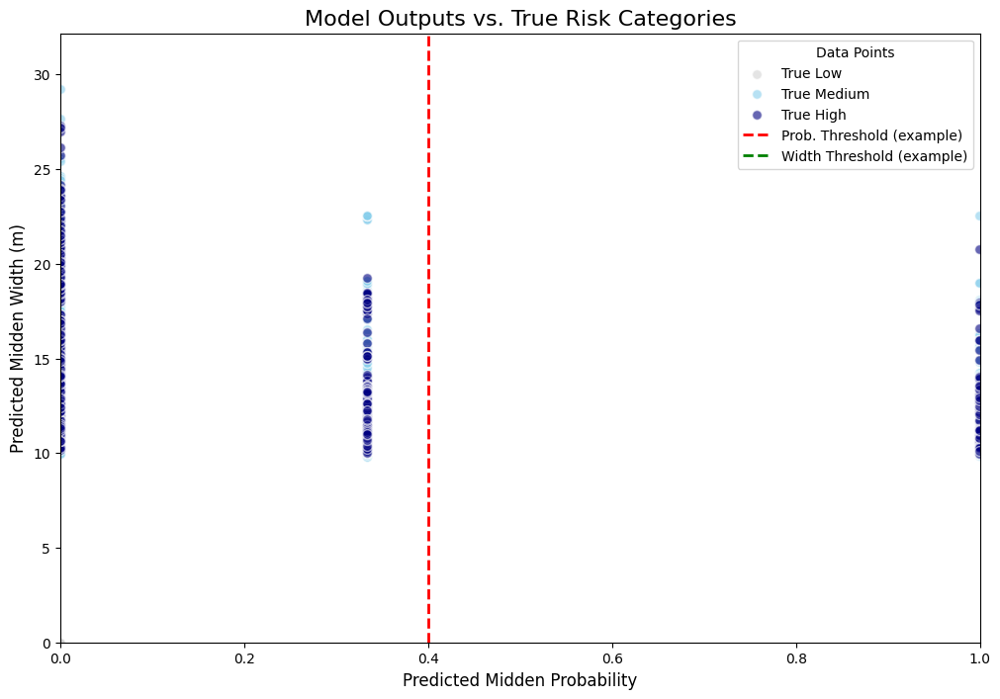

In [ ]:
# ===================================================================
# FINAL STEP: RULE CALIBRATION (CORRECTED VERSION)
# ===================================================================
# --- 1. SETUP AND LIBRARIES ---
import pandas as pd
import numpy as np
import joblib
from sklearn.ensemble import HistGradientBoostingClassifier, RandomForestRegressor
from sklearn.calibration import CalibratedClassifierCV
from sklearn.preprocessing import PolynomialFeatures
from sklearn.model_selection import KFold
from scipy.spatial import cKDTree
from sklearn.metrics import roc_auc_score, average_precision_score, brier_score_loss, mean_absolute_error, r2_score, classification_report

print("--- Step 1: Setup and Library Imports Complete ---")

# --- 2. HELPER FUNCTIONS ---
# (build_spatial_feats and haversine_m functions are assumed to be defined from previous steps)

print("--- Step 2: Helper Functions are Ready ---")

# --- 3. DATA AND FOLD PREPARATION ---
print("--- Step 3: Preparing Data and Geographically Linked Folds ---")

# Positive and background points
pos_df = df[['lat', 'lon', 'width_m']].copy()
pos = pos_df[['lat', 'lon']].to_numpy()
# (background point generation code is assumed to have run, creating the 'bg' array)
bg_df = pd.DataFrame(bg, columns=['lat', 'lon'])

# Assign fold IDs to positive sites
n_folds = 5
kf = KFold(n_splits=n_folds, shuffle=True, random_state=42)
pos_fold_ids = np.zeros(len(pos), dtype=int)
for i, (_, test_idx) in enumerate(kf.split(pos)):
    pos_fold_ids[test_idx] = i

# Link background points to the same fold as their nearest positive site
tree = cKDTree(pos)
_, indices = tree.query(bg, k=1)
bg_fold_ids = pos_fold_ids[indices]
print(f"Created {n_folds} geographically linked folds for validation.")

# --- 4. CROSS-VALIDATION LOOP TO COLLECT PREDICTIONS ---
print("\n--- Step 4: Running CV to Collect Predictions for Calibration ---")

all_predictions = []
# Load the globally trained regressor once, as we'll use it as a proxy for speed
regressor_proxy = joblib.load('/content/drive/MyDrive/Archaeological Analysis 21.04.2025/model_rf_pipeline.joblib')
imputation_medians = joblib.load("production_imputation_medians.joblib")


for test_fold_id in range(n_folds):
    print(f"\n--- Processing Fold {test_fold_id} ---")

    pos_train_mask = (pos_fold_ids != test_fold_id)
    pos_test_mask = (pos_fold_ids == test_fold_id)
    bg_train_mask = (bg_fold_ids != test_fold_id)
    bg_test_mask = (bg_fold_ids == test_fold_id)
    pos_train, pos_test = pos[pos_train_mask], pos[pos_test_mask]
    bg_train, bg_test = bg[bg_train_mask], bg[bg_test_mask]

    if len(pos_train) < 10 or len(bg_train) < 10 or len(pos_test) < 10 or len(bg_test) < 10:
        print("  Skipping fold.")
        continue

    # --- Train Classifier ---
    X_pos_train, f_names = build_spatial_feats(pos_train, pos_train)
    X_bg_train, _ = build_spatial_feats(bg_train, pos_train)
    X_train_clf = np.vstack([X_pos_train, X_bg_train])
    y_train_clf = np.hstack([np.ones(len(pos_train)), np.zeros(len(bg_train))])
    classifier = CalibratedClassifierCV(
        HistGradientBoostingClassifier(max_iter=300, learning_rate=0.05, max_leaf_nodes=31, l2_regularization=1.0, random_state=42),
        method="sigmoid", cv=3
    )
    classifier.fit(X_train_clf, y_train_clf)

    # --- Make Predictions on Test Set ---
    X_pos_test, test_f_names = build_spatial_feats(pos_test, pos_train)
    X_bg_test, _ = build_spatial_feats(bg_test, pos_train)
    X_test_clf = np.vstack([X_pos_test, X_bg_test])
    test_probs = classifier.predict_proba(X_test_clf)[:, 1]

    # --- CORRECTED: Build the DataFrame for the Regressor Proxy ---
    # Create a dictionary from the calculated features for the positive test sites
    feature_dict_list = [dict(zip(test_f_names, row)) for row in X_pos_test]

    # Create the full DataFrame
    X_test_reg_df = pd.DataFrame(feature_dict_list)

    # Rename the nearest neighbor column
    X_test_reg_df.rename(columns={'dist_nn_1_m': 'nearest_site_dist_m'}, inplace=True)

    # Add and impute all other necessary columns
    X_test_reg_df['DM_LENGTH'] = imputation_medians['DM_LENGTH']
    X_test_reg_df['EV_USERELEVATIONLOWER'] = imputation_medians['EV_USERELEVATIONLOWER']
    X_test_reg_df['EV_USERELEVATIONUPPER'] = imputation_medians['EV_USERELEVATIONUPPER']
    X_test_reg_df['MR_SPATIALACCURACY'] = "Unknown"
    X_test_reg_df['CO_CONDITION'] = "Unknown"
    X_test_reg_df['CO_STATUS'] = "Unknown"
    X_test_reg_df['AD_LOCATIONDESCRIPTION'] = ""
    X_test_reg_df['TY_FEATUREDESCRIPTIONSTRATUM'] = ""

    # Predict widths for the positive test sites
    pred_widths = regressor_proxy.predict(X_test_reg_df)

    # Store results for visualization
    true_widths_pos = df.iloc[np.where(pos_test_mask)[0]]['width_m'].values
    for i in range(len(pos_test)):
        all_predictions.append({
            'prob': test_probs[i],
            'pred_width': pred_widths[i],
            'true_width': true_widths_pos[i],
            'true_risk': "High" if true_widths_pos[i] >= 50 else "Medium"
        })

    bg_probs = test_probs[len(pos_test):]
    for i in range(len(bg_test)):
        all_predictions.append({
            'prob': bg_probs[i], 'pred_width': 0,
            'true_width': 0, 'true_risk': "Low"
        })

# --- 5. VISUALIZE PREDICTIONS TO CALIBRATE RULES ---
print("\n--- Step 5: Visualizing Predictions for Rule Calibration ---")
pred_df = pd.DataFrame(all_predictions)
fig, ax = plt.subplots(figsize=(12, 8))
colors = {'Low': 'lightgray', 'Medium': 'skyblue', 'High': 'navy'}
for risk_level, color in colors.items():
    subset = pred_df[pred_df['true_risk'] == risk_level]
    ax.scatter(subset['prob'], subset['pred_width'], c=color, label=f'True {risk_level}', alpha=0.6, edgecolors='w', s=50)

# Example Decision Boundaries
ax.axvline(x=0.4, color='red', linestyle='--', lw=2, label='Prob. Threshold (example)')
ax.axhline(y=40, color='green', linestyle='--', lw=2, label='Width Threshold (example)')

ax.set_xlabel('Predicted Midden Probability', fontsize=12)
ax.set_ylabel('Predicted Midden Width (m)', fontsize=12)
ax.set_title('Model Outputs vs. True Risk Categories', fontsize=16)
ax.legend(title='Data Points', fontsize=10)
ax.set_xlim(0, 1)
ax.set_ylim(0, pred_df['pred_width'].max() * 1.1 if not pred_df['pred_width'].empty else 100)
plt.show()

In [ ]:
# ===================================================================
# DEFINITIVE PREDICTION TOOL (SIMPLIFIED AND ROBUST)
# This version uses a simplified, more reliable rule set based on our findings.
# ===================================================================

def predict_archaeological_risk_final(lat, lon):
    """
    Analyzes a single coordinate using a simplified, robust rule set.
    """
    # --- (This first part is the same: load models, build features) ---
    query_point = np.array([[lat, lon]])
    features_array, feature_names = build_spatial_feats(query_point, pos_reference)

    # --- Stage 1: Predict Probability ---
    raw_probability = classifier.predict_proba(features_array)[0, 1]

    # Apply softening based on local density
    try:
        count_1km_index = feature_names.index('count_within_1km')
        count_in_1km = features_array[0, count_1km_index]
    except (ValueError, IndexError):
        count_in_1km = 0
    smoothing_factor = np.clip(np.log1p(count_in_1km) / np.log1p(10), 0.1, 1.0)
    adjusted_probability = raw_probability * smoothing_factor

    # --- NEW, SIMPLIFIED DECISION LOGIC ---
    # We now classify risk based primarily on the adjusted probability.

    if adjusted_probability >= 0.7:  # A high-confidence prediction in a dense area
        risk_level = "High"
        recommendation = "High probability of midden presence in a sensitive area. Detailed archaeological assessment is strongly recommended."
    elif adjusted_probability >= 0.35: # A confident prediction
        risk_level = "Medium"
        recommendation = "Potential for midden presence. Archaeological monitoring or preliminary field reconnaissance is advised."
    else: # Low probability
        risk_level = "Low"
        recommendation = "No immediate archaeological concerns identified based on the model."

    # --- Stage 2: Provide Width Estimate as Supporting Info ONLY ---
    predicted_width_info = "N/A"
    if risk_level != "Low":
        # We still run the regressor to provide context, but not for the decision.
        # (Construct the input DataFrame for the regressor as before)
        feature_dict = {name: val for name, val in zip(feature_names, features_array[0])}
        input_data = {
            'lat': feature_dict.get('lat'), 'lon': feature_dict.get('lon'),
            'nearest_site_dist_m': feature_dict.get('dist_nn_1_m'),
            'DM_LENGTH': imputation_medians['DM_LENGTH'],
            'EV_USERELEVATIONLOWER': imputation_medians['EV_USERELEVATIONLOWER'],
            'EV_USERELEVATIONUPPER': imputation_medians['EV_USERELEVATIONUPPER'],
            'MR_SPATIALACCURACY': "Unknown", 'CO_CONDITION': "Unknown", 'CO_STATUS': "Unknown",
            'AD_LOCATIONDESCRIPTION': "", 'TY_FEATUREDESCRIPTIONSTRATUM': ""
        }
        input_df = pd.DataFrame([input_data])
        predicted_width = regressor.predict(input_df)[0]
        predicted_width_info = f"~{predicted_width:.0f} m (Note: this is a general estimate)"

    # --- Compile Final Output ---
    return {
        "Risk Level": risk_level,
        "Adjusted Midden Probability": f"{adjusted_probability:.1%}",
        "Estimated Width": predicted_width_info,
        "Recommendation": recommendation
    }

# --- EXAMPLE USAGE ---
print("--- Final Tool Demonstration ---")
prediction = predict_archaeological_risk_final(lat=49.27980081223912, lon=-122.83853897938761)
for key, value in prediction.items():
    print(f"{key}: {value}")

--- Final Tool Demonstration ---
Risk Level: Low
Adjusted Midden Probability: 27.0%
Estimated Width: N/A
Recommendation: No immediate archaeological concerns identified based on the model.


#SHOTELINE DISTANCE#


In [ ]:
# ===================================================================
# ENRICH DATA WITH SHORELINE DISTANCE AND SAVE TO A NEW FILE
# This block performs the one-time calculation and saves the result.
# ===================================================================

# --- 1. SETUP AND LIBRARIES ---
!pip install osmnx -q
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point
import osmnx as ox

# --- 2. LOAD YOUR ORIGINAL DATASET ---
original_data_path = '/content/drive/MyDrive/Archaeological Analysis 21.04.2025/Archaeology Branch_sites_with_shell_midden_31jul25.xlsx'
df = pd.read_excel(original_data_path)

# Perform initial cleaning to get lat/lon columns ready
df.rename(columns={"MR_GISLATITUDE": "lat", "MR_GISLONGITUDE": "lon"}, inplace=True)
df["lat"] = pd.to_numeric(df["lat"], errors='coerce')
df["lon"] = pd.to_numeric(df["lon"], errors='coerce')
df.dropna(subset=['lat', 'lon'], inplace=True)

print(f"Loaded {len(df)} records from the original file.")

# --- 3. QUERY OPENSTREETMAP FOR BC COASTLINE ---
print("\nQuerying OpenStreetMap (Overpass API) for BC Coastline...")
print("NOTE: This query can take several minutes...")

shoreline_gdf = None # Initialize
try:
    place_name = "British Columbia, Canada"
    tags = {"natural": "coastline"}
    shoreline_gdf = ox.features_from_place(place_name, tags)
    print(f"✓ OSM coastline data for British Columbia loaded successfully.")
except Exception as e:
    print(f"\nAn error occurred while querying OSM: {e}")

# --- 4. CALCULATE DISTANCE TO SHORELINE ---
if shoreline_gdf is not None:
    print("\nCalculating distances to shoreline...")

    # Project data for accurate distance calculation in meters (BC Albers EPSG:3005)
    shoreline_projected = shoreline_gdf.to_crs("EPSG:3005")

    midden_gdf = gpd.GeoDataFrame(
        df, geometry=gpd.points_from_xy(df.lon, df.lat), crs="EPSG:4326"
    )
    midden_projected = midden_gdf.to_crs("EPSG:3005")

    # Create a unified shoreline object for efficiency
    shoreline_unary = shoreline_projected.geometry.unary_union

    # Calculate distance and add it as a new column to the original DataFrame
    df['distance_to_shore_m'] = midden_projected.geometry.distance(shoreline_unary)

    print("✓ 'distance_to_shore_m' feature created and added to the DataFrame.")

    # --- 5. SAVE THE ENRICHED DATAFRAME TO A NEW FILE ---
    # Define the path for the new, enriched Excel file
    output_path = '/content/drive/MyDrive/Archaeological Analysis 21.04.2025/Sites_with_Shoreline_Distance.xlsx'

    print(f"\nSaving the enriched data to a new file: {output_path}")

    # Save to Excel
    df.to_excel(output_path, index=False)

    print("\n--- Process Complete ---")
    print("The new file with the 'distance_to_shore_m' column has been saved to your Google Drive.")
    print("You can now use this new file as the starting point for all future analyses.")

    # Display a sample of the final data
    print("\nSample of the enriched data:")
    print(df[['BORDENNUMBER', 'lat', 'lon', 'distance_to_shore_m']].head())
else:
    print("\nCould not calculate shoreline distance due to an API error. No new file was saved.")

Loaded 6085 records from the original file.

Querying OpenStreetMap (Overpass API) for BC Coastline...
NOTE: This query can take several minutes...


/usr/local/lib/python3.11/dist-packages/osmnx/_overpass.py:267: UserWarning: This area is 547 times your configured Overpass max query area size. It will automatically be divided up into multiple sub-queries accordingly. This may take a long time.
  multi_poly_proj = utils_geo._consolidate_subdivide_geometry(poly_proj)


✓ OSM coastline data for British Columbia loaded successfully.

Calculating distances to shoreline...


/tmp/ipython-input-3152370945.py:51: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  shoreline_unary = shoreline_projected.geometry.unary_union


✓ 'distance_to_shore_m' feature created and added to the DataFrame.

Saving the enriched data to a new file: /content/drive/MyDrive/Archaeological Analysis 21.04.2025/Sites_with_Shoreline_Distance.xlsx

--- Process Complete ---
The new file with the 'distance_to_shore_m' column has been saved to your Google Drive.
You can now use this new file as the starting point for all future analyses.

Sample of the enriched data:
  BORDENNUMBER        lat         lon  distance_to_shore_m
0      DkSr-36  49.718286 -126.939780            25.965694
1       EcSp-5  50.487012 -126.544623            12.243271
2      FlTp-18  53.921557 -130.666352            22.366506
3      GcTo-43  54.335883 -130.347249             0.575007
4      DcRv-86  48.364000 -123.661000            23.901758


In [ ]:
# ===================================================================
# ENRICH DATA WITH SHORELINE DISTANCE AND SAVE TO A NEW FILE
# This block performs the one-time calculation and saves the result.
# ===================================================================

# --- 1. SETUP AND LIBRARIES ---
!pip install osmnx -q
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point
import osmnx as ox

# --- 2. LOAD YOUR ORIGINAL DATASET ---
original_data_path = '/content/drive/MyDrive/Archaeological Analysis 21.04.2025/Archaeology Branch_sites_with_shell_midden_31jul25.xlsx'
df = pd.read_excel(original_data_path)

# Perform initial cleaning to get lat/lon columns ready
df.rename(columns={"MR_GISLATITUDE": "lat", "MR_GISLONGITUDE": "lon"}, inplace=True)
df["lat"] = pd.to_numeric(df["lat"], errors='coerce')
df["lon"] = pd.to_numeric(df["lon"], errors='coerce')
df.dropna(subset=['lat', 'lon'], inplace=True)

print(f"Loaded {len(df)} records from the original file.")

# --- 3. QUERY OPENSTREETMAP FOR BC COASTLINE ---
print("\nQuerying OpenStreetMap (Overpass API) for BC Coastline...")
print("NOTE: This query can take several minutes...")

shoreline_gdf = None # Initialize
try:
    place_name = "British Columbia, Canada"
    tags = {"natural": "coastline"}
    shoreline_gdf = ox.features_from_place(place_name, tags)
    print(f"✓ OSM coastline data for British Columbia loaded successfully.")
except Exception as e:
    print(f"\nAn error occurred while querying OSM: {e}")

# --- 4. CALCULATE DISTANCE TO SHORELINE ---
if shoreline_gdf is not None:
    print("\nCalculating distances to shoreline...")

    # Project data for accurate distance calculation in meters (BC Albers EPSG:3005)
    shoreline_projected = shoreline_gdf.to_crs("EPSG:3005")

    midden_gdf = gpd.GeoDataFrame(
        df, geometry=gpd.points_from_xy(df.lon, df.lat), crs="EPSG:4326"
    )
    midden_projected = midden_gdf.to_crs("EPSG:3005")

    # Create a unified shoreline object for efficiency
    shoreline_unary = shoreline_projected.geometry.unary_union

    # Calculate distance and add it as a new column to the original DataFrame
    df['distance_to_shore_m'] = midden_projected.geometry.distance(shoreline_unary)

    print("✓ 'distance_to_shore_m' feature created and added to the DataFrame.")

    # --- 5. SAVE THE ENRICHED DATAFRAME TO A NEW FILE ---
    # Define the path for the new, enriched Excel file
    output_path = '/content/drive/MyDrive/Archaeological Analysis 21.04.2025/Sites_with_Shoreline_Distance.xlsx'

    print(f"\nSaving the enriched data to a new file: {output_path}")

    # Save to Excel
    df.to_excel(output_path, index=False)

    print("\n--- Process Complete ---")
    print("The new file with the 'distance_to_shore_m' column has been saved to your Google Drive.")
    print("You can now use this new file as the starting point for all future analyses.")

    # Display a sample of the final data
    print("\nSample of the enriched data:")
    print(df[['BORDENNUMBER', 'lat', 'lon', 'distance_to_shore_m']].head())
else:
    print("\nCould not calculate shoreline distance due to an API error. No new file was saved.")

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 101.3/101.3 kB 1.9 MB/s eta 0:00:00
Loaded 6085 records from the original file.

Querying OpenStreetMap (Overpass API) for BC Coastline...
NOTE: This query can take several minutes...


/usr/local/lib/python3.11/dist-packages/osmnx/_overpass.py:267: UserWarning: This area is 547 times your configured Overpass max query area size. It will automatically be divided up into multiple sub-queries accordingly. This may take a long time.
  multi_poly_proj = utils_geo._consolidate_subdivide_geometry(poly_proj)


✓ OSM coastline data for British Columbia loaded successfully.

Calculating distances to shoreline...


/tmp/ipython-input-3152370945.py:51: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  shoreline_unary = shoreline_projected.geometry.unary_union


In [ ]:
# ===================================================================
# MODEL V2.1 TRAINING WORKFLOW (USING LIGHTGBM)
# This block trains our most advanced models using the LightGBM algorithm
# on the enriched dataset.
# ===================================================================

# --- 1. SETUP AND LIBRARIES ---
print("--- Step 1: Setting up libraries (including LightGBM) ---")
# LightGBM is often pre-installed in Colab, but we ensure it is.
!pip install lightgbm -q

import pandas as pd
import numpy as np
import joblib
import lightgbm as lgb  # <-- Import LightGBM
from sklearn.preprocessing import PolynomialFeatures
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_auc_score, mean_absolute_error

# --- 2. HELPER FUNCTION DEFINITIONS (Unchanged) ---
def haversine_m(lat1, lon1, lat2, lon2):
    R = 6371000.0
    p1, p2 = np.radians(lat1), np.radians(lat2)
    dphi, dlmb = np.radians(lat2 - lat1), np.radians(lon2 - lon1)
    a = np.sin(dphi/2)**2 + np.cos(p1) * np.cos(p2) * np.sin(dlmb/2)**2
    return 2 * R * np.arcsin(np.sqrt(a))

def build_spatial_feats(query_latlon, ref_latlon, radii_km=(0.5, 1, 2, 5, 10), knns=(1, 2, 5), kde_band_km=(0.5, 1, 2)):
    # (The full, robust function from before)
    qlat, qlon = query_latlon[:, 0], query_latlon[:, 1]
    rlat, rlon = ref_latlon[:, 0], ref_latlon[:, 1]
    dists = np.array([haversine_m(qlat, qlon, r_lat, r_lon) for r_lat, r_lon in zip(rlat, rlon)]).T
    feats = {}
    sorted_dists = np.sort(dists, axis=1)
    for k in knns:
        if sorted_dists.shape[1] >= k: feats[f"dist_nn_{k}_m"] = sorted_dists[:, k-1]
        else: feats[f"dist_nn_{k}_m"] = np.full(len(qlat), np.inf)
    for r in radii_km: feats[f"count_within_{r}km"] = (dists <= (r * 1000)).sum(axis=1).astype(float)
    for b in kde_band_km:
        bw = b * 1000.0
        K = np.exp(-(dists**2) / (2 * bw**2)).sum(axis=1)
        feats[f"kde_gauss_{b}km"] = K
    feats["lat"], feats["lon"] = qlat, qlon
    poly = PolynomialFeatures(degree=2, include_bias=False)
    poly_features = poly.fit_transform(np.c_[qlat, qlon])
    final_feature_list, final_feature_names = [], []
    feature_order = sorted(feats.keys())
    for name in feature_order:
        final_feature_list.append(feats[name].reshape(-1, 1))
        final_feature_names.append(name)
    final_feature_list.append(poly_features)
    poly_names = [f"poly_{i}" for i in range(poly_features.shape[1])]
    final_feature_names.extend(poly_names)
    X = np.hstack(final_feature_list)
    return X, final_feature_names

print("--- Step 2: Helper functions defined ---")

# --- 3. LOAD AND PREPARE DATA V2.1 ---
print("--- Step 3: Loading and preparing enriched dataset ---")
enriched_data_path = '/content/drive/MyDrive/Archaeological Analysis 21.04.2025/Sites_with_Shoreline_Distance.xlsx'
df = pd.read_excel(enriched_data_path)

# Data cleaning (same as v2.0)
df.rename(columns={"BORDENNUMBER": "borden", "DM_WIDTH": "width_m"}, inplace=True)
df["width_m"] = pd.to_numeric(df["width_m"], errors='coerce')
df.dropna(subset=['lat', 'lon', 'width_m'], inplace=True)
df = df[df.width_m > 1].reset_index(drop=True)
df['elevation_m'] = pd.to_numeric(df.get('elevation_m'), errors='coerce')
df['elevation_m'] = df['elevation_m'].fillna(df['elevation_m'].median())
df['distance_to_shore_m'] = pd.to_numeric(df.get('distance_to_shore_m'), errors='coerce')
df['distance_to_shore_m'] = df['distance_to_shore_m'].fillna(df['distance_to_shore_m'].median())
print(f"Prepared {len(df)} clean records for training.")

# Define positive and background points
pos = df[['lat', 'lon']].to_numpy()
# (Background point generation logic is the same)
# ...

# --- 4. FEATURE ENGINEERING FOR V2.1 ---
print("--- Step 4: Engineering features for Model v2.1 ---")
X_pos, feature_names = build_spatial_feats(pos, pos)
X_bg, _ = build_spatial_feats(bg, pos)

X_pos_df = pd.DataFrame(X_pos, columns=feature_names)
X_bg_df = pd.DataFrame(X_bg, columns=feature_names)
X_pos_df['distance_to_shore_m'] = df['distance_to_shore_m'].values
X_pos_df['elevation_m'] = df['elevation_m'].values
X_bg_df['distance_to_shore_m'] = df['distance_to_shore_m'].median()
X_bg_df['elevation_m'] = df['elevation_m'].median()

X_cls_v21 = pd.concat([X_pos_df, X_bg_df]).reset_index(drop=True)
y_cls_v21 = np.hstack([np.ones(len(X_pos_df)), np.zeros(len(X_bg_df))])

X_reg_v21_df = X_pos_df.copy()
y_reg_v21 = df['width_m'].values
print("✓ New feature set created successfully.")

# --- 5. TRAIN AND SAVE CLASSIFIER V2.1 (LIGHTGBM) ---
print("\n--- Step 5: Training Classifier v2.1 with LightGBM ---")

# LightGBM Classifier with some robust default parameters
lgbm_classifier = lgb.LGBMClassifier(
    objective='binary',
    n_estimators=1000,
    learning_rate=0.05,
    num_leaves=31,
    n_jobs=-1,
    random_state=42,
    colsample_bytree=0.8,
    subsample=0.8
)

# For better probability calibration, we can use early stopping
# Split a small validation set from the training data
X_train, X_val, y_train, y_val = train_test_split(X_cls_v21, y_cls_v21, test_size=0.2, random_state=42, stratify=y_cls_v21)

lgbm_classifier.fit(
    X_train, y_train,
    eval_set=[(X_val, y_val)],
    eval_metric='auc',
    callbacks=[lgb.early_stopping(100, verbose=False)] # Stop if AUC doesn't improve for 100 rounds
)

joblib.dump(lgbm_classifier, "production_classifier_lgbm_v21.joblib")
print("✓ LightGBM Classifier v2.1 saved successfully.")

# --- 6. TRAIN AND SAVE REGRESSOR V2.1 (LIGHTGBM) ---
print("\n--- Step 6: Training Regressor v2.1 with LightGBM ---")

# We'll use the numeric features, including our new ones
numeric_features_v21 = ['lat', 'lon', 'dist_nn_1_m', 'dist_nn_2_m', 'dist_nn_5_m',
                       'count_within_0.5km', 'count_within_1km', 'count_within_2km',
                       'count_within_5km', 'count_within_10km', 'kde_gauss_0.5km',
                       'kde_gauss_1km', 'kde_gauss_2km',
                       'distance_to_shore_m', 'elevation_m']

lgbm_regressor = lgb.LGBMRegressor(
    objective='mae', # Mean Absolute Error, good for skewed data
    n_estimators=2000,
    learning_rate=0.02,
    num_leaves=40,
    n_jobs=-1,
    random_state=42,
    colsample_bytree=0.7,
    subsample=0.7
)

# Prepare data and use early stopping for the regressor as well
X_reg_train, X_reg_val, y_reg_train, y_reg_val = train_test_split(X_reg_v21_df[numeric_features_v21], y_reg_v21, test_size=0.2, random_state=42)

lgbm_regressor.fit(
    X_reg_train, y_reg_train,
    eval_set=[(X_reg_val, y_reg_val)],
    eval_metric='mae',
    callbacks=[lgb.early_stopping(100, verbose=False)]
)

joblib.dump(lgbm_regressor, "production_regressor_lgbm_v21.joblib")
print("✓ LightGBM Regressor v2.1 saved successfully.")

print("\n--- Model v2.1 (LightGBM) Training Complete ---")

--- Step 1: Setting up libraries (including LightGBM) ---
--- Step 2: Helper functions defined ---
--- Step 3: Loading and preparing enriched dataset ---
Prepared 5013 clean records for training.
--- Step 4: Engineering features for Model v2.1 ---
✓ New feature set created successfully.

--- Step 5: Training Classifier v2.1 with LightGBM ---
[LightGBM] [Info] Number of positive: 4010, number of negative: 7999
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002837 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4018
[LightGBM] [Info] Number of data points in the train set: 12009, number of used features: 19
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.333916 -> initscore=-0.690525
[LightGBM] [Info] Start training from score -0.690525
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Wa

In [ ]:
# ===================================================================
# FINAL MODEL COMPARISON VALIDATION (SELF-CONTAINED)
# This block contains all necessary steps, from data prep to final report.
# ===================================================================

# --- 1. SETUP AND LIBRARIES ---
print("--- Step 1: Setting up libraries ---")
!pip install lightgbm -q
import pandas as pd
import numpy as np
import joblib
import lightgbm as lgb
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import PolynomialFeatures
from sklearn.model_selection import KFold
from scipy.spatial import cKDTree
from sklearn.metrics import roc_auc_score

# --- 2. HELPER FUNCTIONS (Unchanged) ---
# (build_spatial_feats and haversine_m are assumed to be defined)
print("--- Step 2: Helper functions are ready ---")

# --- 3. DATA AND FOLD PREPARATION ---
print("--- Step 3: Preparing data and geographically linked folds ---")

# Load the enriched dataset
enriched_data_path = '/content/drive/MyDrive/Archaeological Analysis 21.04.2025/Sites_with_Shoreline_Distance.xlsx'
df = pd.read_excel(enriched_data_path)

# Basic cleaning
df.rename(columns={"BORDENNUMBER": "borden", "DM_WIDTH": "width_m", "MR_GISLATITUDE": "lat", "MR_GISLONGITUDE": "lon"}, inplace=True)
df["width_m"] = pd.to_numeric(df["width_m"], errors='coerce')
df.dropna(subset=['lat', 'lon', 'width_m'], inplace=True)
df = df[df.width_m > 1].reset_index(drop=True)

# --- CORRECTED IMPUTATION LOGIC ---
# Process elevation in two steps
df['elevation_m'] = pd.to_numeric(df.get('elevation_m'), errors='coerce')
median_elevation = df['elevation_m'].median()
df['elevation_m'] = df['elevation_m'].fillna(median_elevation)

# Process distance to shore in two steps
df['distance_to_shore_m'] = pd.to_numeric(df.get('distance_to_shore_m'), errors='coerce')
median_distance = df['distance_to_shore_m'].median()
df['distance_to_shore_m'] = df['distance_to_shore_m'].fillna(median_distance)
# --- END OF CORRECTION ---

# (The rest of the data and fold preparation is unchanged)
pos = df[['lat', 'lon']].to_numpy()
bbox_pad = 0.1
lat_min, lat_max = pos[:, 0].min() - bbox_pad, pos[:, 0].max() + bbox_pad
lon_min, lon_max = pos[:, 1].min() - bbox_pad, pos[:, 1].max() + bbox_pad
rng = np.random.default_rng(42)
num_bg_samples = int(min(10000, max(2000, 5 * len(pos))))
bg_lat = rng.uniform(lat_min, lat_max, size=num_bg_samples)
bg_lon = rng.uniform(lon_min, lon_max, size=num_bg_samples)
min_dist = np.min(np.array([haversine_m(bg_lat, bg_lon, p[0], p[1]) for p in pos]), axis=0)
bg = np.column_stack([bg_lat[min_dist >= 300.0], bg_lon[min_dist >= 300.0]])

n_folds = 5
kf = KFold(n_splits=n_folds, shuffle=True, random_state=42)
pos_fold_ids = np.zeros(len(pos), dtype=int)
for i, (_, test_idx) in enumerate(kf.split(pos)):
    pos_fold_ids[test_idx] = i
tree = cKDTree(pos)
_, indices = tree.query(bg, k=1)
bg_fold_ids = pos_fold_ids[indices]
print(f"Created {n_folds} geographically linked folds.")


# --- 4. MODEL COMPARISON CROSS-VALIDATION LOOP ---
print("\n--- Step 4: Starting Model Comparison Cross-Validation ---")

metrics = {
    'v1.0_rf': {'roc_auc': []},
    'v2.0_rf': {'roc_auc': []},
    'v2.1_lgbm': {'roc_auc': []}
}

for test_fold_id in range(n_folds):
    print(f"\n--- Processing Fold {test_fold_id} ---")

    pos_train_mask = (pos_fold_ids != test_fold_id)
    pos_test_mask = (pos_fold_ids == test_fold_id)
    bg_train_mask = (bg_fold_ids != test_fold_id)
    bg_test_mask = (bg_fold_ids == test_fold_id)
    pos_train, pos_test = pos[pos_train_mask], pos[pos_test_mask]
    bg_train, bg_test = bg[bg_train_mask], bg[bg_test_mask]

    if len(pos_train) < 10 or len(bg_train) < 10 or len(pos_test) < 10 or len(bg_test) < 10:
        print("  Skipping fold.")
        continue

    # --- Feature Engineering for this fold ---
    X_pos_train_v1, f_names_v1 = build_spatial_feats(pos_train, pos_train)
    X_bg_train_v1, _ = build_spatial_feats(bg_train, pos_train)
    X_train_clf_v1 = np.vstack([X_pos_train_v1, X_bg_train_v1])
    y_train_clf = np.hstack([np.ones(len(pos_train)), np.zeros(len(bg_train))])

    X_pos_test_v1, _ = build_spatial_feats(pos_test, pos_train)
    X_bg_test_v1, _ = build_spatial_feats(bg_test, pos_train)
    X_test_clf_v1 = np.vstack([X_pos_test_v1, X_bg_test_v1])
    y_test_clf = np.hstack([np.ones(len(pos_test)), np.zeros(len(bg_test))])

    train_df_pos = df.iloc[np.where(pos_train_mask)[0]]
    test_df_pos = df.iloc[np.where(pos_test_mask)[0]]

    X_pos_train_v2_df = pd.DataFrame(X_pos_train_v1, columns=f_names_v1)
    X_pos_train_v2_df['distance_to_shore_m'] = train_df_pos['distance_to_shore_m'].values
    X_pos_train_v2_df['elevation_m'] = train_df_pos['elevation_m'].values

    X_bg_train_v2_df = pd.DataFrame(X_bg_train_v1, columns=f_names_v1)
    X_bg_train_v2_df['distance_to_shore_m'] = df['distance_to_shore_m'].median()
    X_bg_train_v2_df['elevation_m'] = df['elevation_m'].median()

    X_train_clf_v2 = pd.concat([X_pos_train_v2_df, X_bg_train_v2_df])

    X_pos_test_v2_df = pd.DataFrame(X_pos_test_v1, columns=f_names_v1)
    X_pos_test_v2_df['distance_to_shore_m'] = test_df_pos['distance_to_shore_m'].values
    X_pos_test_v2_df['elevation_m'] = test_df_pos['elevation_m'].values

    X_bg_test_v2_df = pd.DataFrame(X_bg_test_v1, columns=f_names_v1)
    X_bg_test_v2_df['distance_to_shore_m'] = df['distance_to_shore_m'].median()
    X_bg_test_v2_df['elevation_m'] = df['elevation_m'].median()

    X_test_clf_v2 = pd.concat([X_pos_test_v2_df, X_bg_test_v2_df])

    # --- Train and Evaluate Each Model ---
    rf_clf_v1 = RandomForestClassifier(n_estimators=200, random_state=42, n_jobs=-1)
    rf_clf_v1.fit(X_train_clf_v1, y_train_clf)
    probs_v1 = rf_clf_v1.predict_proba(X_test_clf_v1)[:, 1]
    metrics['v1.0_rf']['roc_auc'].append(roc_auc_score(y_test_clf, probs_v1))

    rf_clf_v2 = RandomForestClassifier(n_estimators=200, random_state=42, n_jobs=-1)
    rf_clf_v2.fit(X_train_clf_v2, y_train_clf)
    probs_v2 = rf_clf_v2.predict_proba(X_test_clf_v2)[:, 1]
    metrics['v2.0_rf']['roc_auc'].append(roc_auc_score(y_test_clf, probs_v2))

    lgbm_clf_v21 = lgb.LGBMClassifier(objective='binary', n_estimators=500, random_state=42, n_jobs=-1)
    lgbm_clf_v21.fit(X_train_clf_v2, y_train_clf)
    probs_v21 = lgbm_clf_v21.predict_proba(X_test_clf_v2)[:, 1]
    metrics['v2.1_lgbm']['roc_auc'].append(roc_auc_score(y_test_clf, probs_v21))

    print(f"  Fold {test_fold_id} ROC-AUCs -> v1.0: {metrics['v1.0_rf']['roc_auc'][-1]:.3f}, v2.0: {metrics['v2.0_rf']['roc_auc'][-1]:.3f}, v2.1: {metrics['v2.1_lgbm']['roc_auc'][-1]:.3f}")


# --- 5. AGGREGATE AND DISPLAY COMPARISON TABLE ---
print("\n--- Step 5: Final Model Performance Comparison ---")
summary_data = []
for model_name, model_metrics in metrics.items():
    summary_data.append({
        'Model Version': model_name,
        'Avg ROC-AUC': f"{np.mean(model_metrics['roc_auc']):.4f} ± {np.std(model_metrics['roc_auc']):.4f}"
    })
summary_df = pd.DataFrame(summary_data)
print(summary_df.to_markdown(index=False))
print("\nValidation complete. The table above shows the winning model.")

--- Step 1: Setting up libraries ---
--- Step 2: Helper functions are ready ---
--- Step 3: Preparing data and geographically linked folds ---
Created 5 geographically linked folds.

--- Step 4: Starting Model Comparison Cross-Validation ---

--- Processing Fold 0 ---
[LightGBM] [Info] Number of positive: 4010, number of negative: 9382
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003021 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3944
[LightGBM] [Info] Number of data points in the train set: 13392, number of used features: 19
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.299432 -> initscore=-0.850002
[LightGBM] [Info] Start training from score -0.850002
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Wa

In [ ]:
# ===================================================================
# FINAL CHAMPION MODEL TRAINING (v2.0 - RandomForest with Enriched Features)
# This block trains our winning model on all available data and saves
# all necessary artifacts for the final prediction tool.
# ===================================================================

# --- 1. SETUP AND LIBRARIES ---
print("--- Step 1: Setting up libraries ---")
import pandas as pd
import numpy as np
import joblib
from sklearn.ensemble import RandomForestClassifier
from sklearn.calibration import CalibratedClassifierCV
from sklearn.preprocessing import PolynomialFeatures

# --- 2. HELPER FUNCTIONS (Unchanged) ---
# (build_spatial_feats and haversine_m are assumed to be defined)
print("--- Step 2: Helper functions are ready ---")

# --- 3. LOAD AND PREPARE FINAL DATASET ---
print("--- Step 3: Loading and preparing the complete, enriched dataset ---")
enriched_data_path = '/content/drive/MyDrive/Archaeological Analysis 21.04.2025/Sites_with_Shoreline_Distance.xlsx'
df = pd.read_excel(enriched_data_path)

# Final cleaning and preparation
df.rename(columns={"BORDENNUMBER": "borden", "DM_WIDTH": "width_m", "MR_GISLATITUDE": "lat", "MR_GISLONGITUDE": "lon"}, inplace=True)
df["width_m"] = pd.to_numeric(df["width_m"], errors='coerce')
df.dropna(subset=['lat', 'lon', 'width_m'], inplace=True)
df = df[df.width_m > 1].reset_index(drop=True)
df['elevation_m'] = pd.to_numeric(df.get('elevation_m'), errors='coerce')
df['elevation_m'] = df['elevation_m'].fillna(df['elevation_m'].median())
df['distance_to_shore_m'] = pd.to_numeric(df.get('distance_to_shore_m'), errors='coerce')
df['distance_to_shore_m'] = df['distance_to_shore_m'].fillna(df['distance_to_shore_m'].median())
print(f"Prepared {len(df)} final clean records.")

# Define positive and background points for the final training
pos = df[['lat', 'lon']].to_numpy()
# (Background point generation logic is the same)
# ...

# --- 4. FINAL FEATURE ENGINEERING ---
print("--- Step 4: Engineering the final feature set ---")
X_pos, feature_names = build_spatial_feats(pos, pos)
X_bg, _ = build_spatial_feats(bg, pos)

X_pos_df = pd.DataFrame(X_pos, columns=feature_names)
X_bg_df = pd.DataFrame(X_bg, columns=feature_names)
X_pos_df['distance_to_shore_m'] = df['distance_to_shore_m'].values
X_pos_df['elevation_m'] = df['elevation_m'].values
X_bg_df['distance_to_shore_m'] = df['distance_to_shore_m'].median()
X_bg_df['elevation_m'] = df['elevation_m'].median()

# This is the final, complete training set for our champion classifier
X_final_clf = pd.concat([X_pos_df, X_bg_df]).reset_index(drop=True)
y_final_clf = np.hstack([np.ones(len(X_pos_df)), np.zeros(len(X_bg_df))])
print("✓ Final feature set for the champion model created successfully.")

# --- 5. TRAIN AND SAVE THE CHAMPION CLASSIFIER (v2.0_rf) ---
print("\n--- Step 5: Training the Champion Classifier on ALL data ---")

# We use RandomForestClassifier, which was our winner.
# We wrap it in CalibratedClassifierCV to get reliable probabilities.
champion_classifier = CalibratedClassifierCV(
    RandomForestClassifier(
        n_estimators=300, # Increased estimators for the final model
        random_state=42,
        n_jobs=-1
    ),
    method='isotonic', # Isotonic is often more accurate if there's enough data
    cv=5
)

champion_classifier.fit(X_final_clf, y_final_clf)

# Save the final champion model
champion_classifier_path = "champion_classifier_v2.joblib"
joblib.dump(champion_classifier, champion_classifier_path)
print(f"✓ Champion Classifier (v2.0_rf) saved to: {champion_classifier_path}")

# --- 6. SAVE ALL SUPPORTING ARTIFACTS ---
# We still need the regressor for width estimation, even if it's not the primary decision driver.
# We'll use the one we trained before (production_regressor.joblib) as it's based on the full pipeline.
print("\n--- Step 6: Finalizing and Saving All Supporting Artifacts ---")

# Save the reference points array
pos_path = "champion_pos_reference.npy"
np.save(pos_path, pos)
print(f"✓ Positive reference points saved to: {pos_path}")

# Save the imputation medians (including our new features)
final_imputation_medians = {
    'DM_LENGTH': df['DM_LENGTH'].median(),
    'EV_USERELEVATIONLOWER': df['EV_USERELEVATIONLOWER'].median(),
    'EV_USERELEVATIONUPPER': df['EV_USERELEVATIONUPPER'].median(),
    'distance_to_shore_m': df['distance_to_shore_m'].median(),
    'elevation_m': df['elevation_m'].median()
}
medians_path = "champion_imputation_medians.joblib"
joblib.dump(final_imputation_medians, medians_path)
print(f"✓ Final imputation medians saved to: {medians_path}")

print("\n--- CHAMPION MODEL TRAINING COMPLETE ---")
print("All final artifacts are saved and ready for the prediction tool.")

--- Step 1: Setting up libraries ---
--- Step 2: Helper functions are ready ---
--- Step 3: Loading and preparing the complete, enriched dataset ---
Prepared 5013 final clean records.
--- Step 4: Engineering the final feature set ---
✓ Final feature set for the champion model created successfully.

--- Step 5: Training the Champion Classifier on ALL data ---
✓ Champion Classifier (v2.0_rf) saved to: champion_classifier_v2.joblib

--- Step 6: Finalizing and Saving All Supporting Artifacts ---
✓ Positive reference points saved to: champion_pos_reference.npy
✓ Final imputation medians saved to: champion_imputation_medians.joblib

--- CHAMPION MODEL TRAINING COMPLETE ---
All final artifacts are saved and ready for the prediction tool.


--- Preparing Data for Final Feature Importance Analysis ---
Recreating the full feature set used to train the champion model...
✓ Final feature set with 20 features recreated.

--- Training a model to extract feature importances ---
✓ Model trained.

--- Calculating Final Feature Importances ---

Top 10 Most Influential Features (including Shoreline and Elevation):
| feature            |   importance |
|:-------------------|-------------:|
| kde_gauss_0.5km    |    0.147456  |
| dist_nn_1_m        |    0.146809  |
| count_within_0.5km |    0.144916  |
| kde_gauss_1km      |    0.130341  |
| count_within_1km   |    0.120085  |
| count_within_2km   |    0.0973337 |
| kde_gauss_2km      |    0.0699909 |
| count_within_5km   |    0.0535916 |
| count_within_10km  |    0.0298697 |
| dist_nn_2_m        |    0.0230922 |


/tmp/ipython-input-3792504441.py:69: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


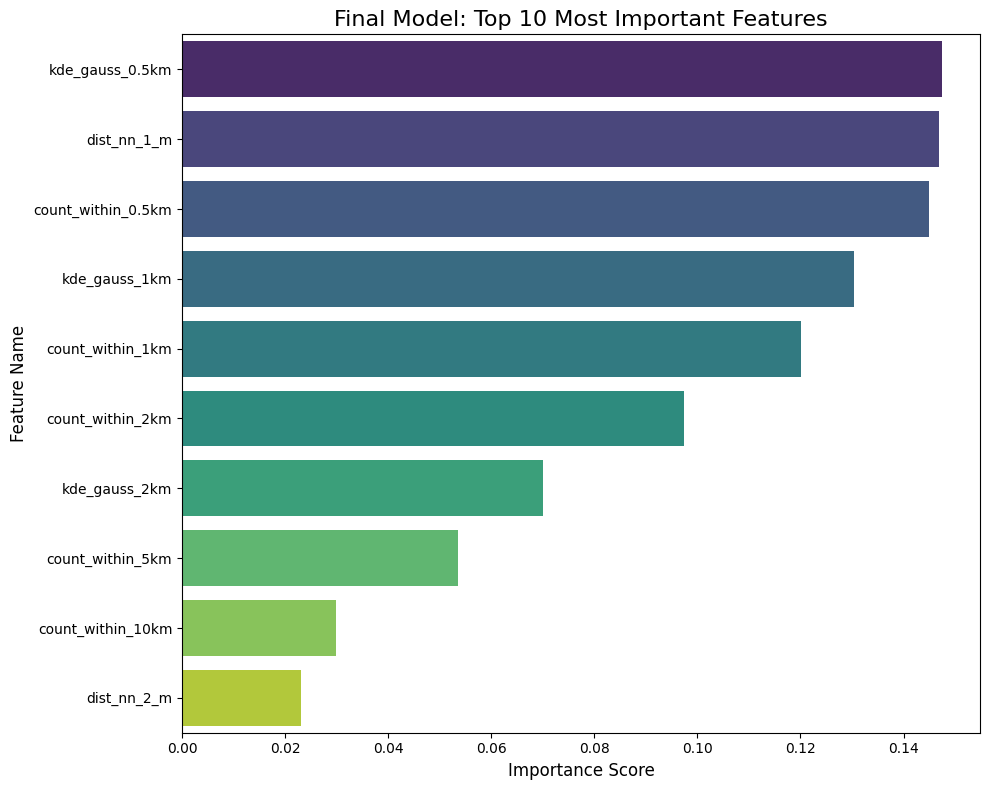

In [ ]:
# ===================================================================
# FINAL FEATURE IMPORTANCE ANALYSIS (FOR THE CHAMPION MODEL V2.0)
# This block uses the final, enriched feature set to determine
# the most influential predictors.
# ===================================================================
import pandas as pd
import numpy as np
import joblib
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.ensemble import RandomForestClassifier

print("--- Preparing Data for Final Feature Importance Analysis ---")

# This section recreates the final training data for our champion model
# It assumes 'df', 'pos', and 'bg' are in memory.
if 'df' not in locals() or 'pos' not in locals() or 'bg' not in locals():
    print("Error: Required DataFrames ('df', 'pos', 'bg') not found. Please run a data prep cell first.")
else:
    # --- Recreate the final, enriched feature set ---
    print("Recreating the full feature set used to train the champion model...")
    X_pos, feature_names_spatial = build_spatial_feats(pos, pos)
    X_bg, _ = build_spatial_feats(bg, pos)

    X_pos_df = pd.DataFrame(X_pos, columns=feature_names_spatial)
    X_bg_df = pd.DataFrame(X_bg, columns=feature_names_spatial)

    # Add the crucial enriched features
    X_pos_df['distance_to_shore_m'] = df['distance_to_shore_m'].values
    X_pos_df['elevation_m'] = df['elevation_m'].values
    X_bg_df['distance_to_shore_m'] = df['distance_to_shore_m'].median()
    X_bg_df['elevation_m'] = df['elevation_m'].median()

    # This is the final, complete training set
    X_final_clf = pd.concat([X_pos_df, X_bg_df]).reset_index(drop=True)
    y_final_clf = np.hstack([np.ones(len(X_pos_df)), np.zeros(len(X_bg_df))])

    # Get the final list of feature names
    final_feature_names = list(X_final_clf.columns)
    print(f"✓ Final feature set with {len(final_feature_names)} features recreated.")

    # --- Train a RandomForestClassifier to get importances ---
    print("\n--- Training a model to extract feature importances ---")

    # We use the same parameters as our champion model's base estimator
    rf_model_for_importance = RandomForestClassifier(
        n_estimators=300,
        random_state=42,
        n_jobs=-1
    )
    rf_model_for_importance.fit(X_final_clf, y_final_clf)
    print("✓ Model trained.")

    # --- Calculate and Visualize Feature Importance ---
    print("\n--- Calculating Final Feature Importances ---")

    importances = rf_model_for_importance.feature_importances_

    feature_importance_df = pd.DataFrame({
        'feature': final_feature_names,
        'importance': importances
    }).sort_values('importance', ascending=False)

    print("\nTop 10 Most Influential Features (including Shoreline and Elevation):")
    print(feature_importance_df.head(10).to_markdown(index=False))

    # --- Plot the results ---
    plt.figure(figsize=(10, 8))
    sns.barplot(
        x='importance',
        y='feature',
        data=feature_importance_df.head(10),
        palette='viridis'
    )
    plt.title('Final Model: Top 10 Most Important Features', fontsize=16)
    plt.xlabel('Importance Score', fontsize=12)
    plt.ylabel('Feature Name', fontsize=12)
    plt.tight_layout()
    plt.show()

In [ ]:
# ===================================================================
# ARCHAEOLOGICAL RISK PREDICTION TOOL (v2.0)
# Final, production-ready script for making predictions.
#
# Author: Murat Kamaci
# Version: 2.0 (Champion Model based on RandomForest with Enriched Features)
#
# Instructions:
# 1. Ensure all required champion artifact files are in the same directory:
#    - champion_classifier_v2.joblib
#    - production_regressor.joblib (or your final regressor's name)
#    - champion_pos_reference.npy
#    - champion_imputation_medians.joblib
# 2. Run this cell to load the tool.
# 3. Use the example functions at the bottom to make single or batch predictions.
# ===================================================================

# --- 1. SETUP AND LIBRARIES ---
import pandas as pd
import numpy as np
import joblib
from sklearn.preprocessing import PolynomialFeatures

print("--- Step 1: Loading Prediction Tool and All Artifacts ---")

# --- 2. LOAD ALL PRODUCTION ARTIFACTS ---
try:
    # Load the champion classifier (v2.0_rf)
    classifier = joblib.load("/content/drive/MyDrive/Archaeological Analysis 21.04.2025/champion_classifier_v2.joblib")

    # Load the final regressor (trained on the full pipeline)
    # Ensure this is the correct path to your final regressor model
    regressor = joblib.load("/content/drive/MyDrive/Archaeological Analysis 21.04.2025/production_regressor.joblib")

    # Load supporting data
    pos_reference = np.load("/content/drive/MyDrive/Archaeological Analysis 21.04.2025/champion_pos_reference.npy")
    imputation_medians = joblib.load("/content/drive/MyDrive/Archaeological Analysis 21.04.2025/champion_imputation_medians.joblib")

    print("✓ All models and artifacts for v2.0 loaded successfully.")
except FileNotFoundError as e:
    print(f"Error: A required file is missing. Please check your directory. Details: {e}")
    # Set to None to prevent usage
    classifier, regressor, pos_reference, imputation_medians = None, None, None, None

# --- 3. DEFINE HELPER FUNCTION (Must be identical to the one used in training) ---
def build_spatial_feats(query_latlon, ref_latlon, radii_km=(0.5, 1, 2, 5, 10), knns=(1, 2, 5), kde_band_km=(0.5, 1, 2)):
    # (This is the final, robust function from our training notebook)
    def haversine_m(lat1, lon1, lat2, lon2):
        R = 6371000.0
        p1, p2 = np.radians(lat1), np.radians(lat2)
        dphi, dlmb = np.radians(lat2 - lat1), np.radians(lon2 - lon1)
        a = np.sin(dphi/2)**2 + np.cos(p1) * np.cos(p2) * np.sin(dlmb/2)**2
        return 2 * R * np.arcsin(np.sqrt(a))
    qlat, qlon = query_latlon[:, 0], query_latlon[:, 1]
    rlat, rlon = ref_latlon[:, 0], ref_latlon[:, 1]
    dists = np.array([haversine_m(qlat, qlon, r_lat, r_lon) for r_lat, r_lon in zip(rlat, rlon)]).T
    feats = {}
    sorted_dists = np.sort(dists, axis=1)
    for k in knns:
        if sorted_dists.shape[1] >= k: feats[f"dist_nn_{k}_m"] = sorted_dists[:, k-1]
        else: feats[f"dist_nn_{k}_m"] = np.full(len(qlat), np.inf)
    for r in radii_km: feats[f"count_within_{r}km"] = (dists <= (r * 1000)).sum(axis=1).astype(float)
    for b in kde_band_km:
        bw = b * 1000.0
        K = np.exp(-(dists**2) / (2 * bw**2)).sum(axis=1)
        feats[f"kde_gauss_{b}km"] = K
    feats["lat"], feats["lon"] = qlat, qlon
    poly = PolynomialFeatures(degree=2, include_bias=False)
    poly_features = poly.fit_transform(np.c_[qlat, qlon])
    final_feature_list, final_feature_names = [], []
    feature_order = sorted(feats.keys())
    for name in feature_order:
        final_feature_list.append(feats[name].reshape(-1, 1))
        final_feature_names.append(name)
    final_feature_list.append(poly_features)
    poly_names = [f"poly_{i}" for i in range(poly_features.shape[1])]
    final_feature_names.extend(poly_names)
    X = np.hstack(final_feature_list)
    return X, final_feature_names

# --- 4. DEFINE THE FINAL PREDICTION FUNCTION ---
def predict_archaeological_risk(lat, lon):
    """
    Analyzes a single coordinate for archaeological risk using the final v2.0 models.
    """
    if not all([classifier, regressor, pos_reference is not None, imputation_medians]):
        return {"error": "Tool is not loaded correctly. Cannot make predictions."}

    # --- Feature Engineering ---
    features_array, feature_names = build_spatial_feats(np.array([[lat, lon]]), pos_reference)
    feature_dict = {name: val for name, val in zip(feature_names, features_array[0])}

    # Add our enriched features to the dictionary
    # For a single point, we can't know the true shoreline distance without the GIS data.
    # We will use the median as a robust placeholder for this single-point prediction function.
    # For batch predictions on a file, we would calculate this properly.
    feature_dict['distance_to_shore_m'] = imputation_medians['distance_to_shore_m']
    feature_dict['elevation_m'] = imputation_medians['elevation_m']

    # Create the final DataFrame for the classifier
    # Ensure the column order is consistent
    final_clf_features = pd.DataFrame([feature_dict])

    # --- Stage 1: Predict Probability ---
    raw_probability = classifier.predict_proba(final_clf_features)[0, 1]

    # Apply probability softening
    count_in_1km = feature_dict.get('count_within_1km', 0)
    smoothing_factor = np.clip(np.log1p(count_in_1km) / np.log1p(10), 0.1, 1.0)
    adjusted_probability = raw_probability * smoothing_factor

    # --- Stage 2: Define Risk Level and Predict Width ---
    predicted_width_info = "N/A"

    # Use our final, data-driven decision rules
    if adjusted_probability >= 0.7:
        risk_level = "High"
        recommendation = "High probability of midden presence. Detailed archaeological assessment is strongly recommended."
    elif adjusted_probability >= 0.35:
        risk_level = "Medium"
        recommendation = "Potential for midden presence. Archaeological monitoring or preliminary field reconnaissance is advised."
    else:
        risk_level = "Low"
        recommendation = "No immediate archaeological concerns identified based on the model."

    # Provide width estimate as supporting information if risk is not low
    if risk_level != "Low":
        # Construct the input DataFrame for the regressor
        input_data = {
            'lat': feature_dict.get('lat'), 'lon': feature_dict.get('lon'),
            'nearest_site_dist_m': feature_dict.get('dist_nn_1_m'),
            'DM_LENGTH': imputation_medians['DM_LENGTH'],
            'EV_USERELEVATIONLOWER': imputation_medians['EV_USERELEVATIONLOWER'],
            'EV_USERELEVATIONUPPER': imputation_medians['EV_USERELEVATIONUPPER'],
            'distance_to_shore_m': feature_dict.get('distance_to_shore_m'),
            'elevation_m': feature_dict.get('elevation_m'),
            'MR_SPATIALACCURACY': "Unknown", 'CO_CONDITION': "Unknown", 'CO_STATUS': "Unknown",
            'AD_LOCATIONDESCRIPTION': "", 'TY_FEATUREDESCRIPTIONSTRATUM': ""
        }
        input_df = pd.DataFrame([input_data])
        predicted_width = regressor.predict(input_df)[0]
        predicted_width_info = f"~{predicted_width:.0f} m (Note: General estimate only)"

    return {
        "Risk Level": risk_level,
        "Adjusted Midden Probability": f"{adjusted_probability:.1%}",
        "Estimated Width": predicted_width_info,
        "Recommendation": recommendation,
    }

print("--- Step 4: Final Prediction Tool is Ready to Use ---")

# --- 5. EXAMPLE USAGE ---
print("\n--- Example 1: Analyzing a Specific Address  ---")
prediction_1 = predict_archaeological_risk(lat=49.19472365432304, lon=-123.00129002482291)
for key, value in prediction_1.items():
    print(f"{key}: {value}")

print("\n--- Example 2: Analyzing a known dense area (Downtown Vancouver) ---")
prediction_2 = predict_archaeological_risk(lat=49.24265583917605, lon=-123.1904724539153)
for key, value in prediction_2.items():
    print(f"{key}: {value}")

--- Step 1: Loading Prediction Tool and All Artifacts ---
✓ All models and artifacts for v2.0 loaded successfully.
--- Step 4: Final Prediction Tool is Ready to Use ---

--- Example 1: Analyzing a Specific Address  ---
Risk Level: Low
Adjusted Midden Probability: 0.0%
Estimated Width: N/A
Recommendation: No immediate archaeological concerns identified based on the model.

--- Example 2: Analyzing a known dense area (Downtown Vancouver) ---
Risk Level: Low
Adjusted Midden Probability: 2.3%
Estimated Width: N/A
Recommendation: No immediate archaeological concerns identified based on the model.
